In [1]:
import pandas as pd
import geopandas as gpd
import os
import numpy as np
import matplotlib.pyplot as plt
import pickle
import shap
from shapely import Point, wkt
import osmnx as ox
import contextily as ctx
import seaborn as sns
from hdbscan import HDBSCAN

# !pip install spatial-kfold
from spatialkfold.blocks import spatial_blocks 
from spatialkfold.clusters import spatial_kfold_clusters 
from sklearn.model_selection import train_test_split, GridSearchCV, LeaveOneGroupOut, cross_validate, GroupKFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from xgboost import XGBRegressor


random_seed = 100

london = ox.geocode_to_gdf('Greater London, UK')
london.to_crs(epsg=27700, inplace=True)
boros = gpd.read_file(os.path.join('data','shapefile','statistical-gis-boundaries-london','ESRI','London_Borough_Excluding_MHW.shp'))
boros.to_crs(epsg=27700, inplace=True)

In [2]:
df = pd.read_csv('data/cleaned/df_ml_new.csv',low_memory=True)
df['geometry'] = df['geometry'].apply(wkt.loads)
df = gpd.GeoDataFrame(df, geometry='geometry', crs='EPSG:27700')
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 16890 entries, 0 to 16889
Data columns (total 39 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   id_code                    16890 non-null  object  
 1   geometry                   16890 non-null  geometry
 2   population                 16890 non-null  float64 
 3   poi_banking                16890 non-null  float64 
 4   poi_hotels                 16890 non-null  float64 
 5   poi_leisure_active         16890 non-null  float64 
 6   poi_leisure_entertainment  16890 non-null  float64 
 7   poi_leisure_outdoor        16890 non-null  float64 
 8   poi_medical                16890 non-null  float64 
 9   poi_nature                 16890 non-null  float64 
 10  poi_public_facilities      16890 non-null  float64 
 11  poi_religious              16890 non-null  float64 
 12  poi_restaurants            16890 non-null  float64 
 13  poi_shopping           

In [3]:
# define target variable columns
targets = ['Total', 'Morning', 'Midday', 'Evening', 'Late']
targets_log = ['log_'+t for t in targets]

# Log transform the target variable
for col in targets:
    df['log_'+col] = df[col].apply(lambda x: 0 if x==0 else np.log(x))

In [4]:
# define feature columns
features = ['population', 
            'poi_banking', 'poi_hotels','poi_leisure_active', 'poi_leisure_entertainment','poi_leisure_outdoor',
            'poi_medical', 'poi_nature', 'poi_public_facilities', 'poi_religious','poi_restaurants','poi_tourism','poi_shopping',
            'transport_bus','transport_rail','transport_other',
            'diversity_poi','diversity_transp_mode','diversity_transp_opt',
            'cent_bus_degree','cent_bus_closeness','cent_bus_betweenness',
            'cent_rail_degree','cent_rail_closeness','cent_rail_betweenness'
            ]

features_main = ['population', 
            'poi_banking', 'poi_hotels','poi_leisure_active', 'poi_leisure_entertainment','poi_leisure_outdoor',
            'poi_medical', 'poi_nature', 'poi_public_facilities', 'poi_religious','poi_restaurants','poi_tourism','poi_shopping',
            'transport_bus','transport_rail','transport_other'
            ]

# lags as features
lags = ['lag_'+t for t in targets] #to pick one depending on the target

In [5]:
# Set up spatial cross-validation folds

df_point = df.copy()
df_point['geometry'] = [Point(x,y) for x,y in zip(df_point['x_coords'],df_point['y_coords'])]
df_point = gpd.GeoDataFrame(df_point, geometry='geometry', crs='EPSG:27700')

# Global SHAP
(use shap_list_)

In [6]:
# load 
with open('data/modeltraining/shap_list.pkl', 'rb') as file:
    shap_list = pickle.load(file)
with open('data/modeltraining/shap_list_test.pkl', 'rb') as file:
    shap_list_ = pickle.load(file)

Beeswarm


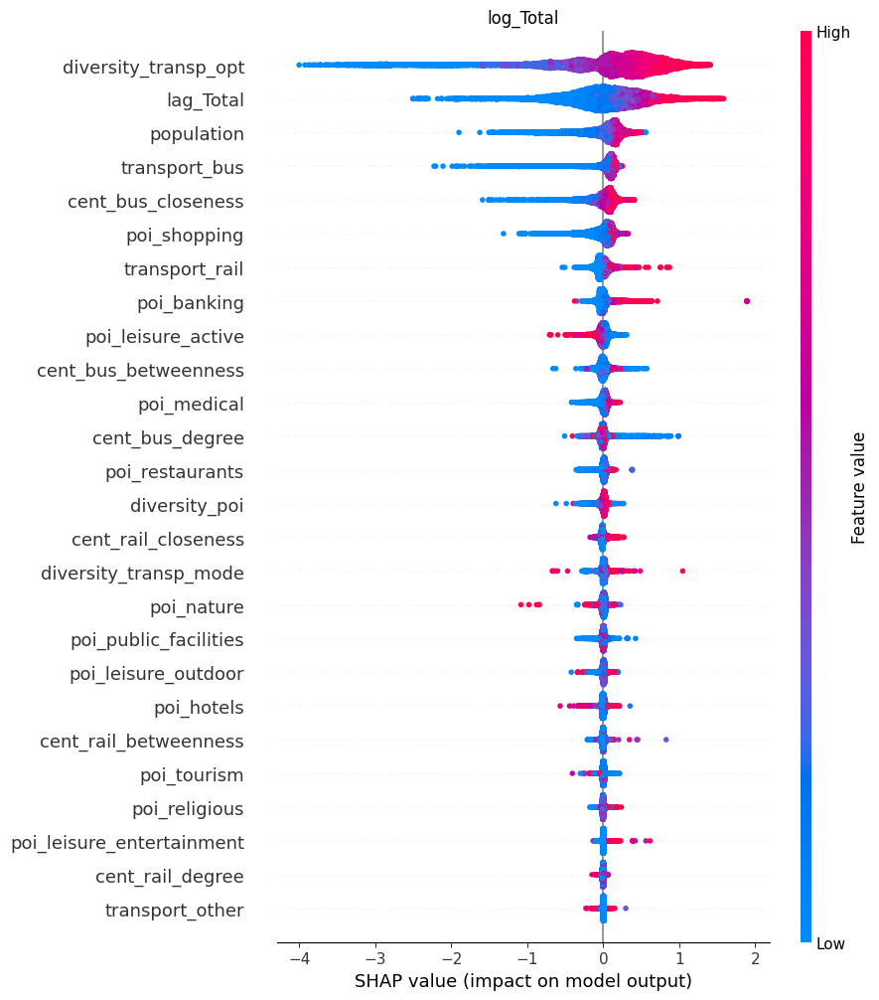

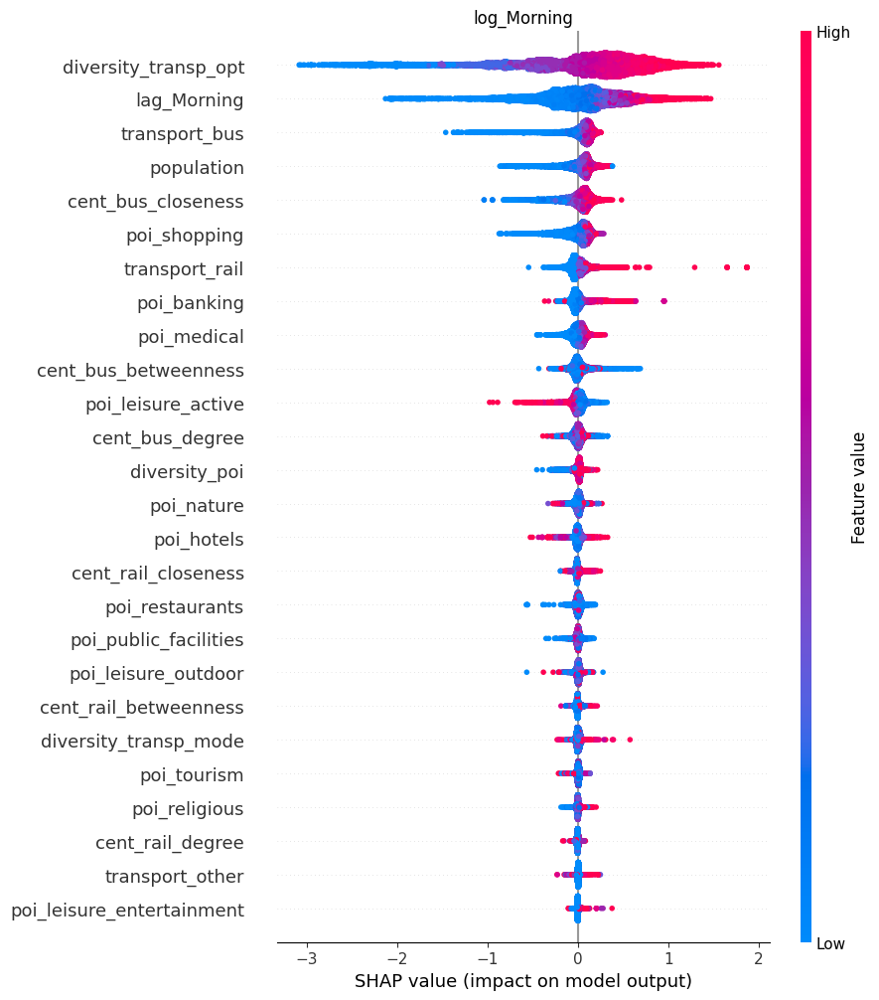

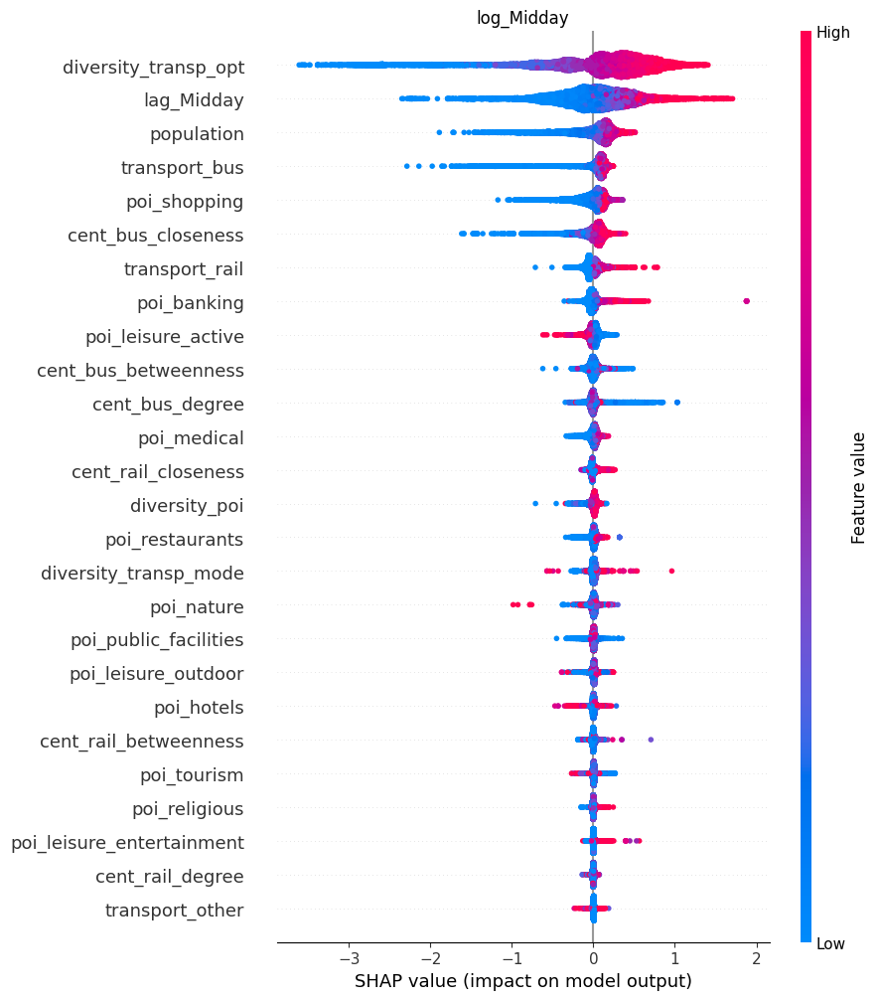

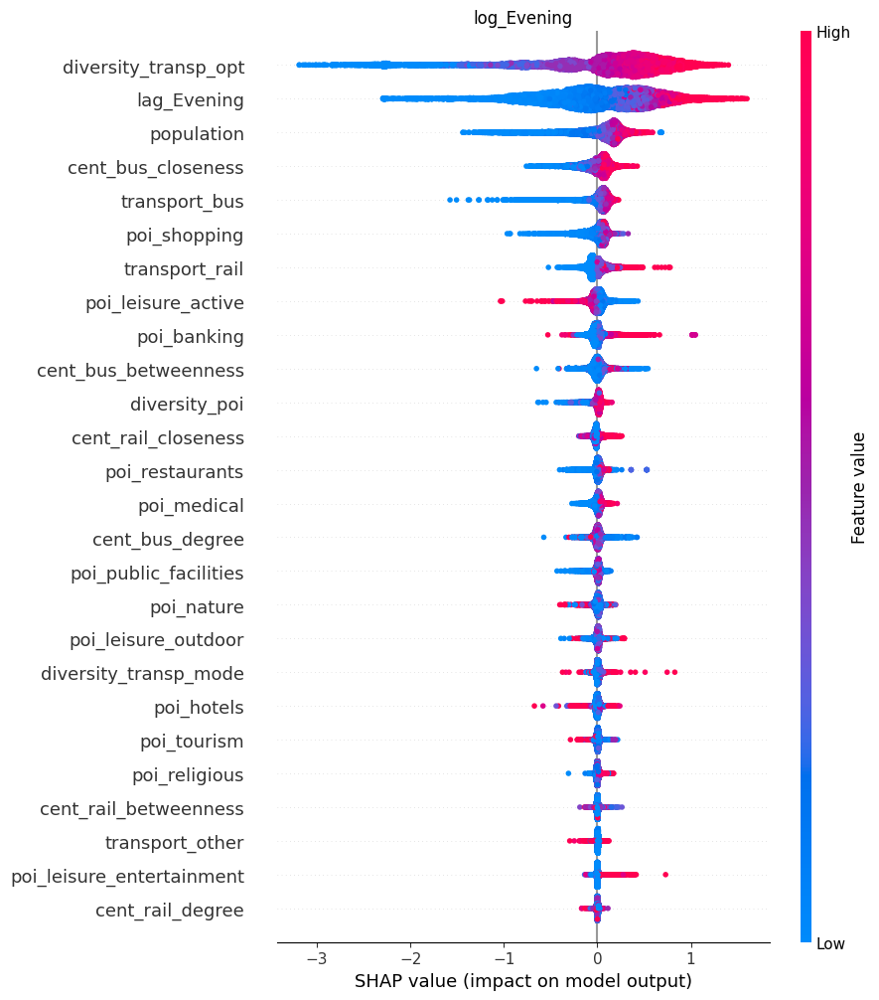

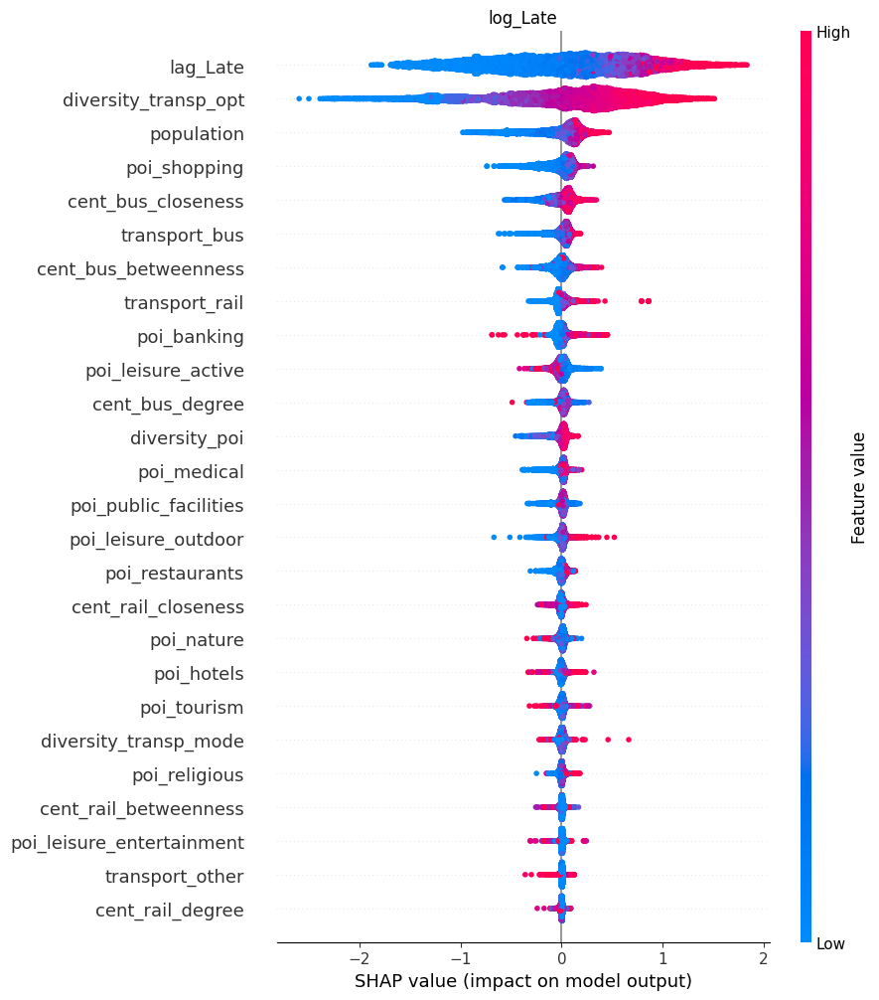

In [29]:
# Bee swarm plot for each target
print(f"Beeswarm")
for target in shap_list.keys():
    shap.plots.beeswarm(shap_list[target], max_display=30, show=False)
    plt.title(f"{target}")
    # plt.savefig(f"output/shap/beeswarm_{target}.png")
    plt.show()

27it [00:25,  1.61s/it]                        


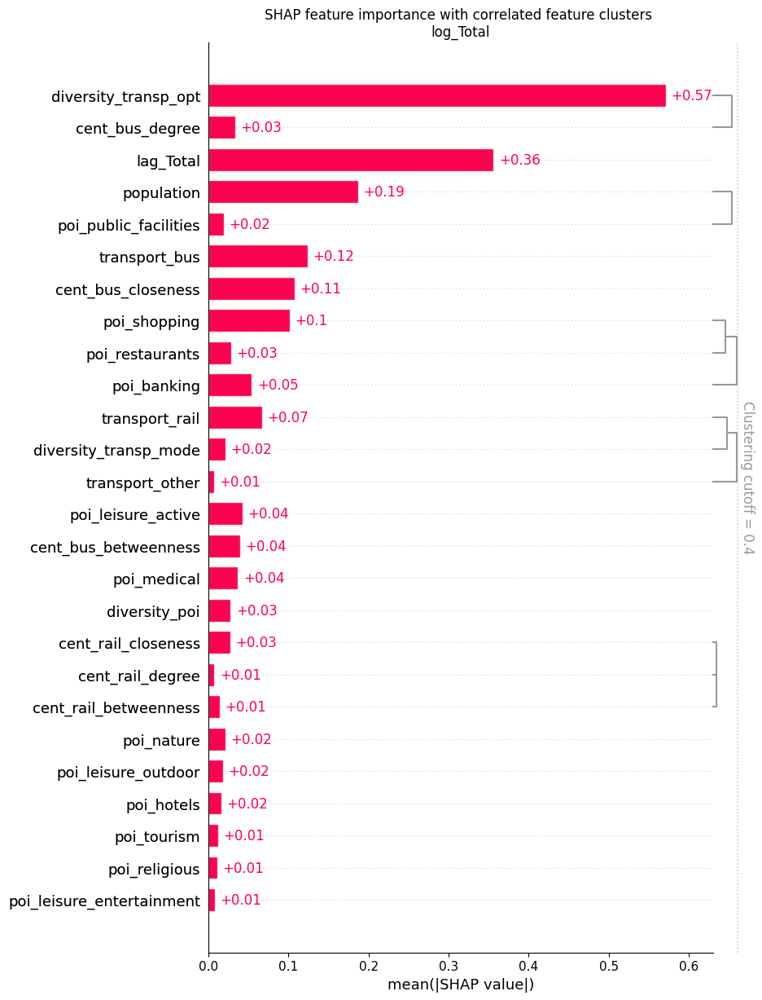

27it [00:24,  1.72s/it]                        


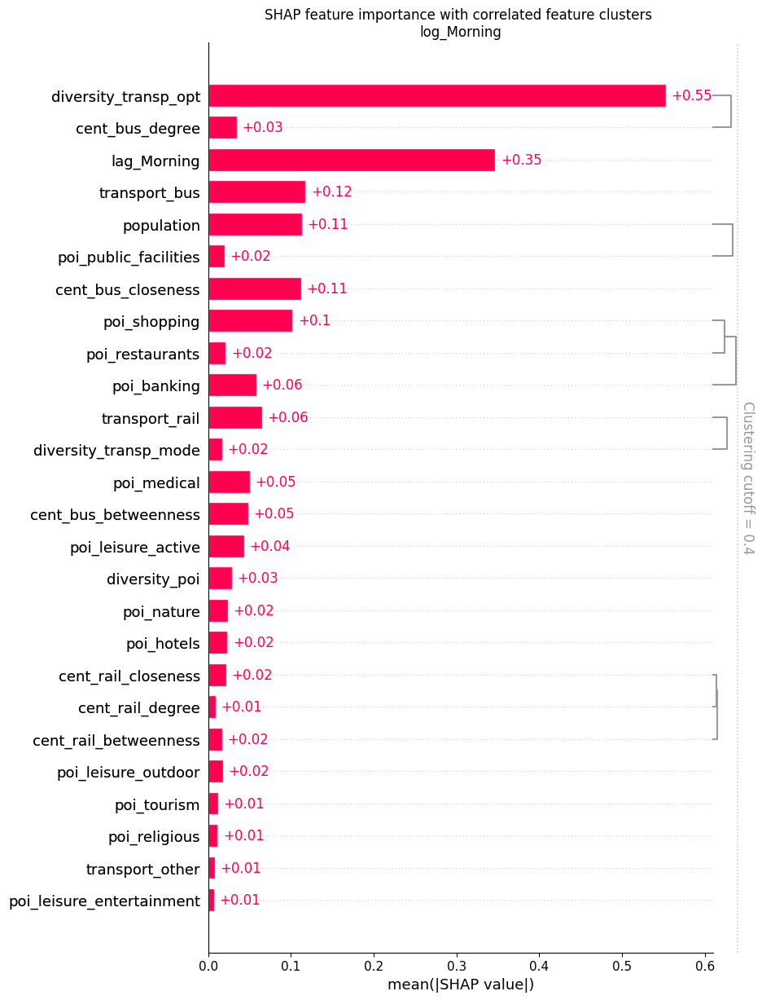

27it [00:23,  1.59s/it]                        


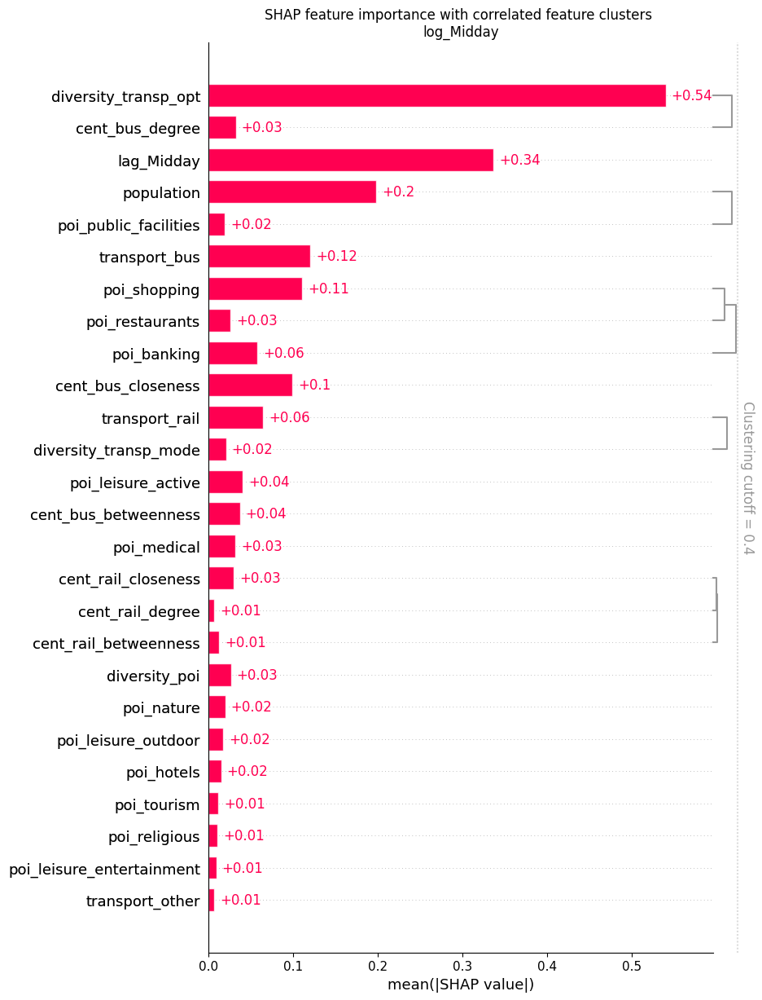

27it [00:22,  1.61s/it]                        


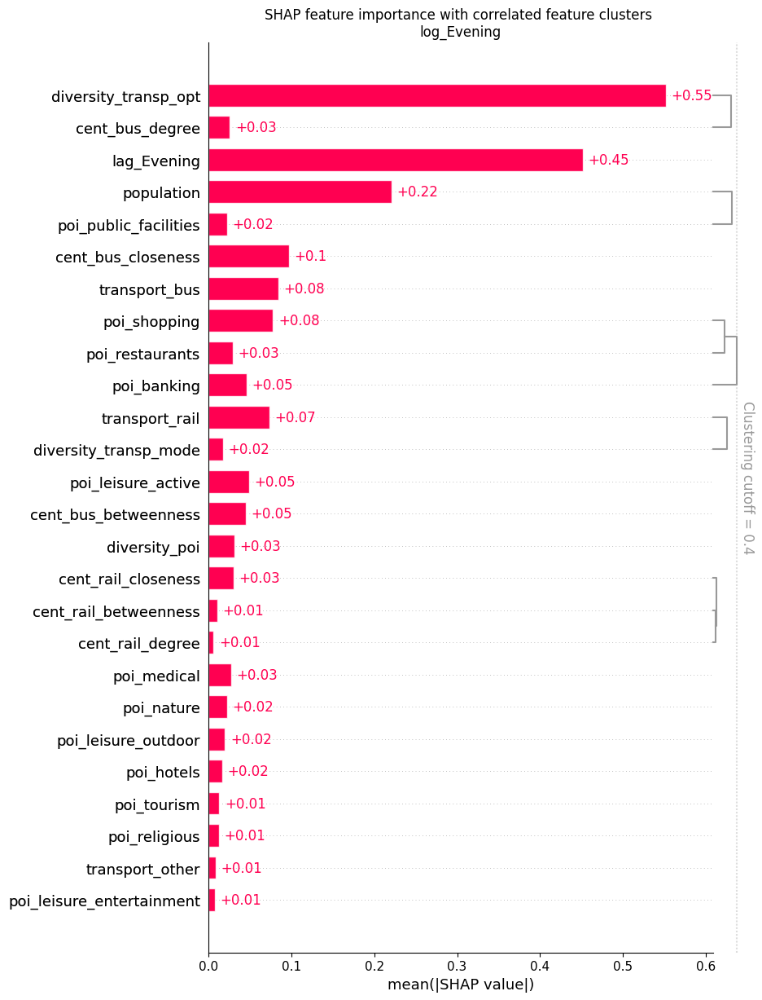

27it [00:24,  1.74s/it]                        


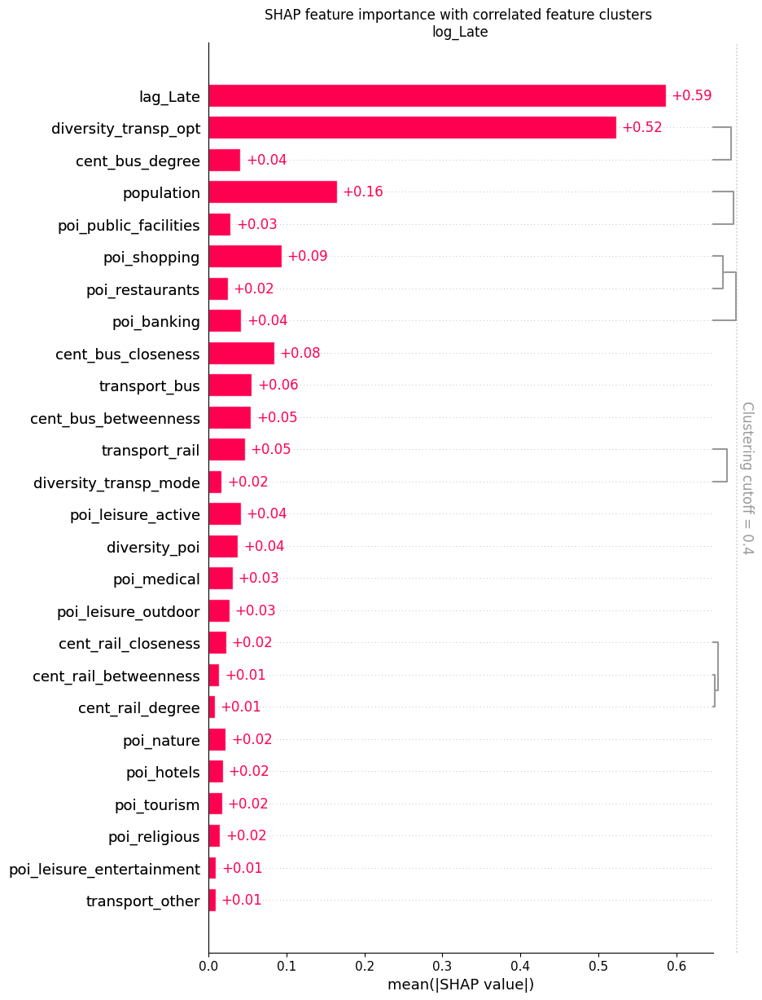

In [30]:
# bar clustering plot for each target
for target in targets_log:
    shap_values = shap_list[target]
    
    target_sel = target
    features_sel = features + [lags[targets_log.index(target_sel)]] 

    X = df[features_sel]
    y = df[target_sel]

    clustering = shap.utils.hclust(X,y,metric='xgboost_distances_r2')

    shap.plots.bar(shap_values, max_display=30, clustering=clustering, clustering_cutoff=0.4,show=False)
    plt.title('SHAP feature importance with correlated feature clusters \n'+target)
    # plt.savefig(f'output/shap/new_barclus_{target}.png')
    plt.show()

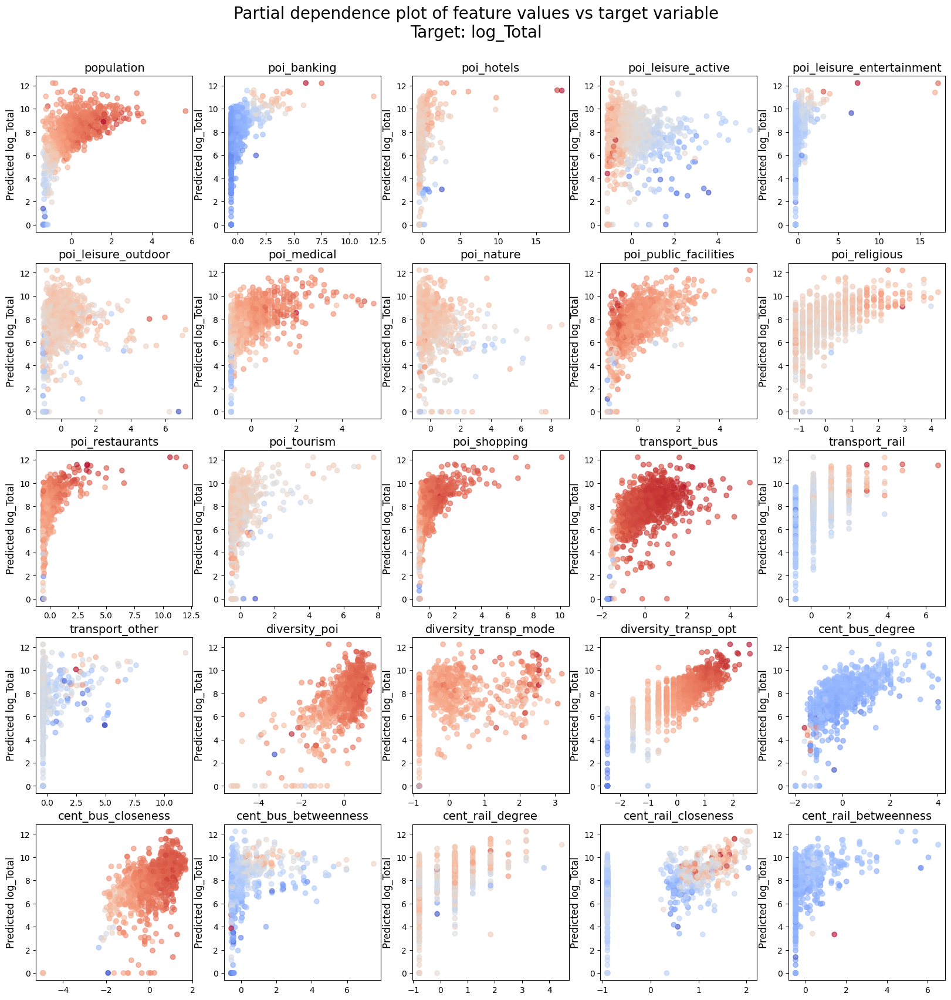

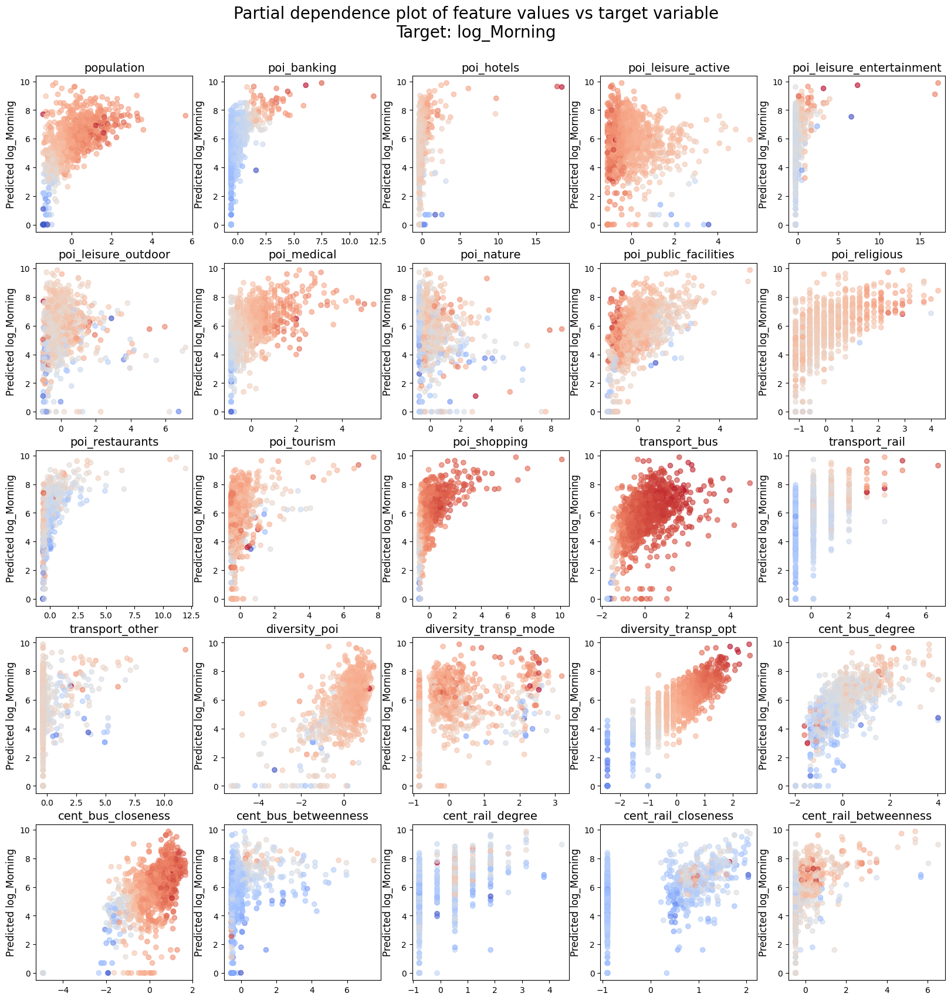

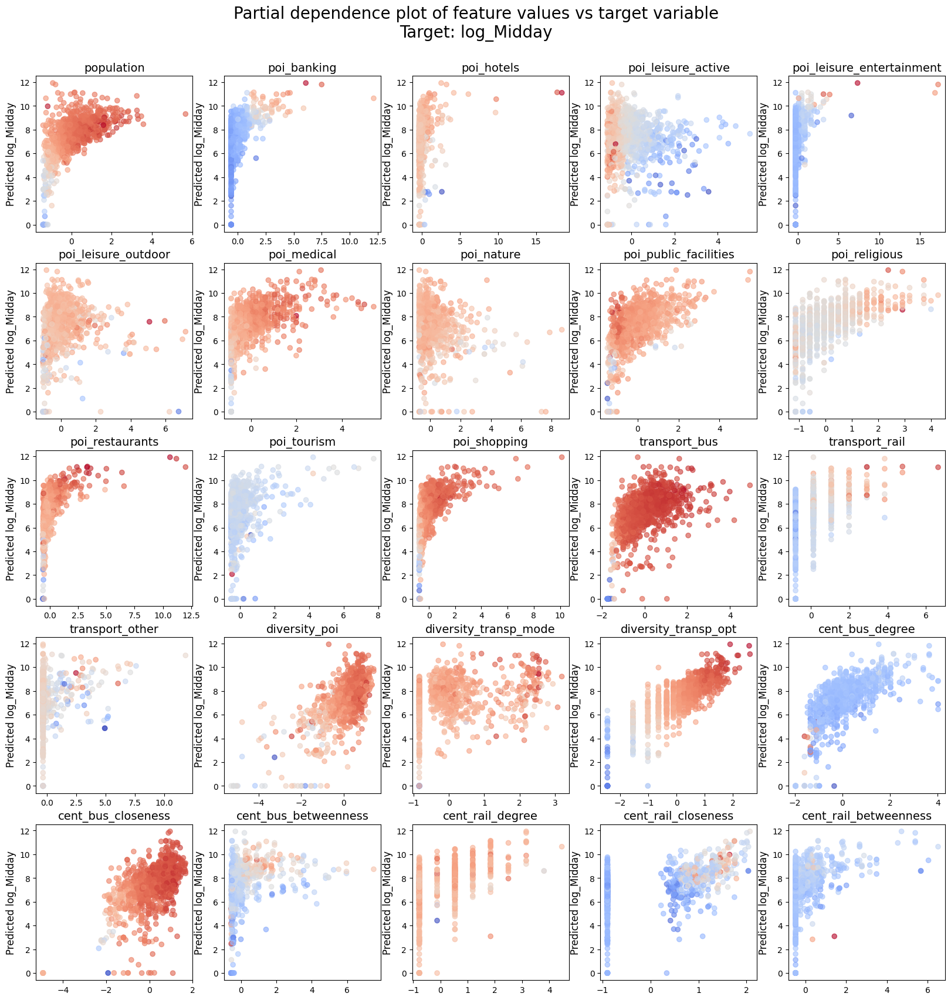

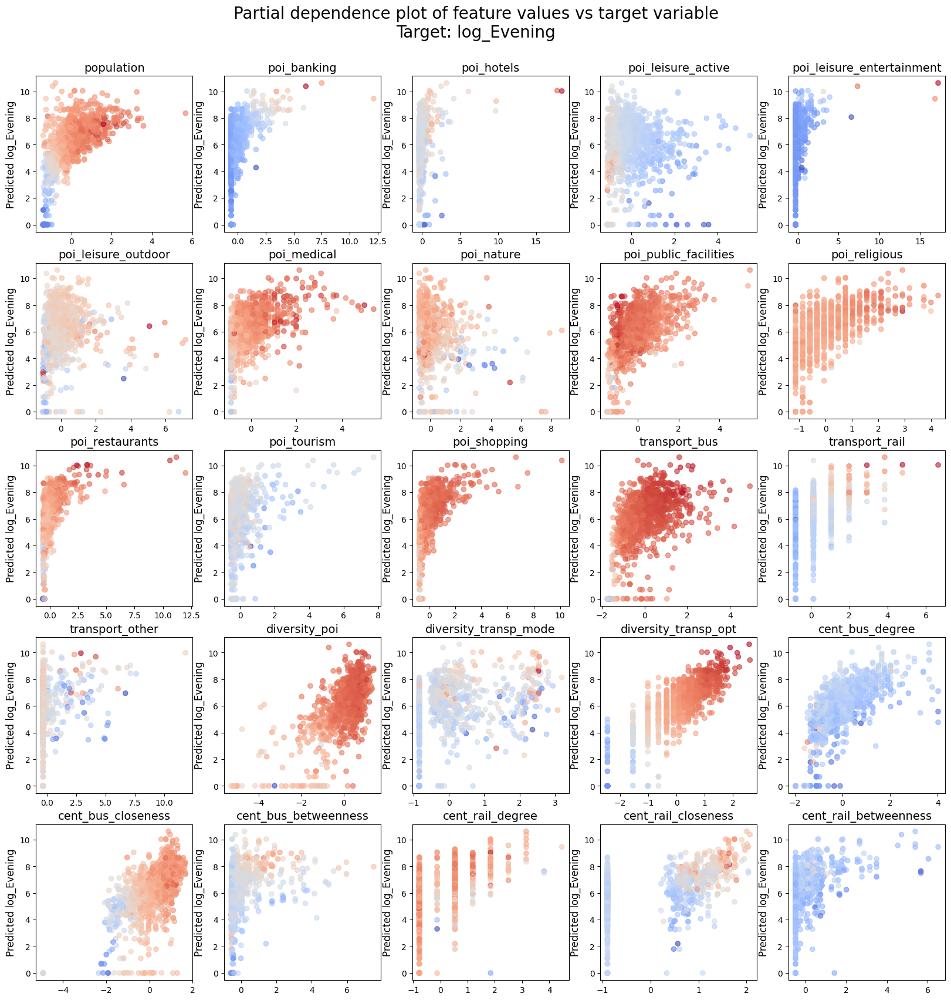

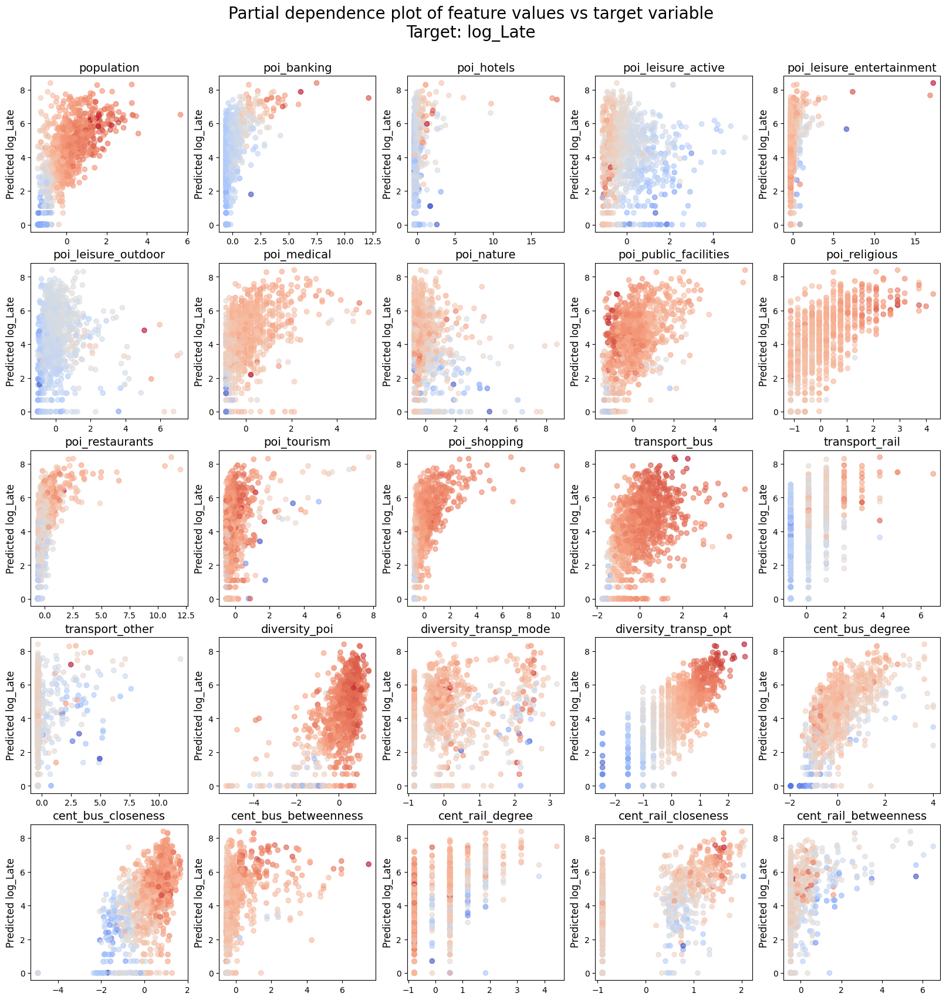

In [77]:
# Scatter Plot for all features
    
for target,shap_values in shap_list_.items():
    fig, ax = plt.subplots(5,5,figsize=(20,20))

    # train model and get prediction

    X = df[features + [lags[targets_log.index(target)]]]
    y = df[target]

    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    model.fit(X, y)

    # Explain the X_test data
    X_explain = pd.DataFrame(X, columns=features + [lags[targets_log.index(target)]])
    X_explain = X_explain.sample(1000, random_state=random_seed,axis=0)
    y_pred = model.predict(X_explain)
    y_pred = pd.DataFrame(y_pred, columns=[target])

    for j in range(25):
        ax = ax.ravel()
        ax[j].scatter(X_explain.iloc[:,j],y_pred.values,c=shap_values.values[:,j],cmap='coolwarm',alpha=0.6)
        ax[j].set_title(features[j],fontsize=14)
        ax[j].set_ylabel('Predicted '+target,fontsize=12)
    
    plt.suptitle(f'Partial dependence plot of feature values vs target variable\nTarget: {target}', fontsize=20, y=0.94)
    plt.savefig(os.path.join('output','shap',f'shap_depplot_xy_{target}.png'))
    plt.show()

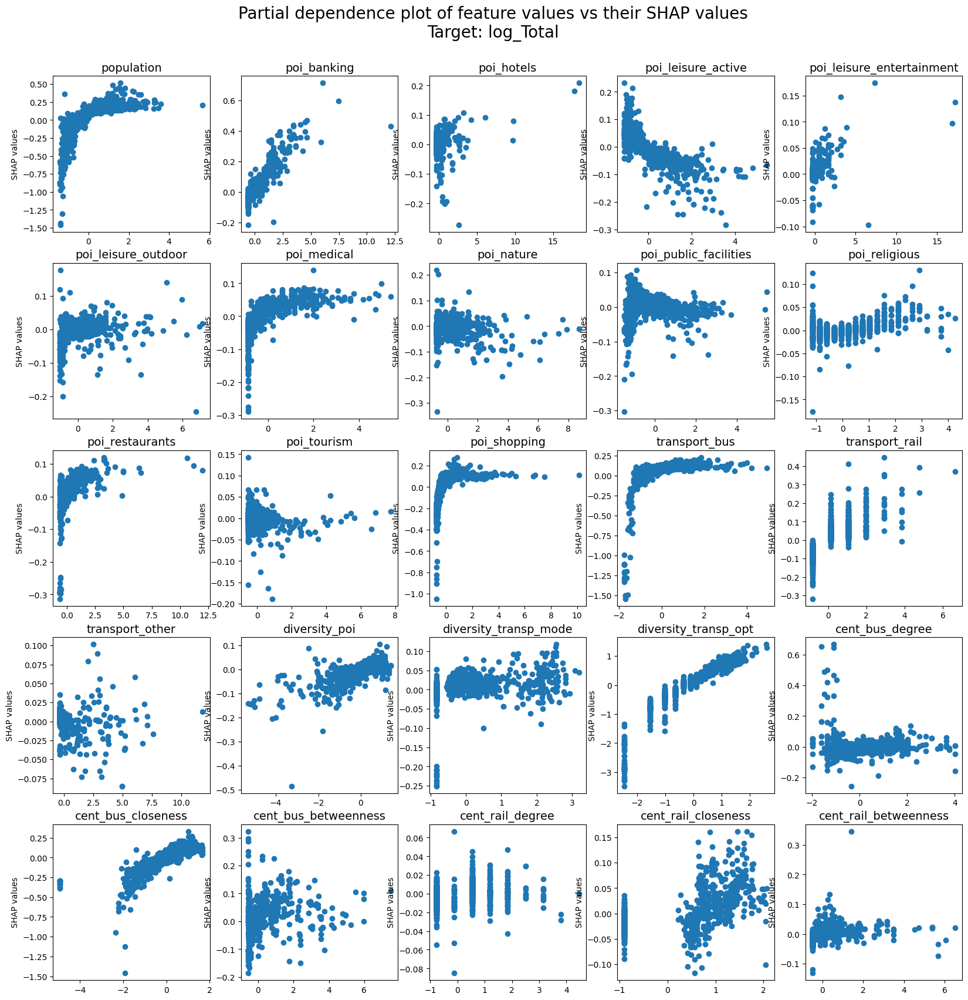

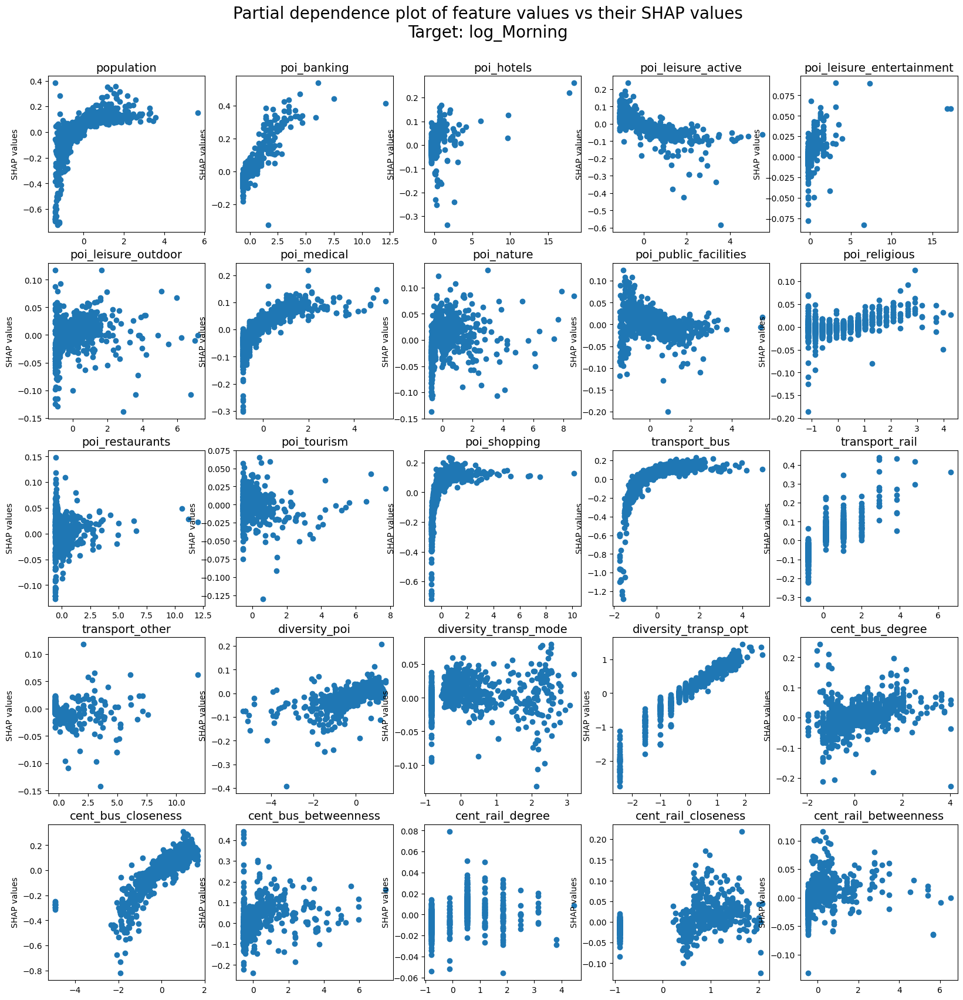

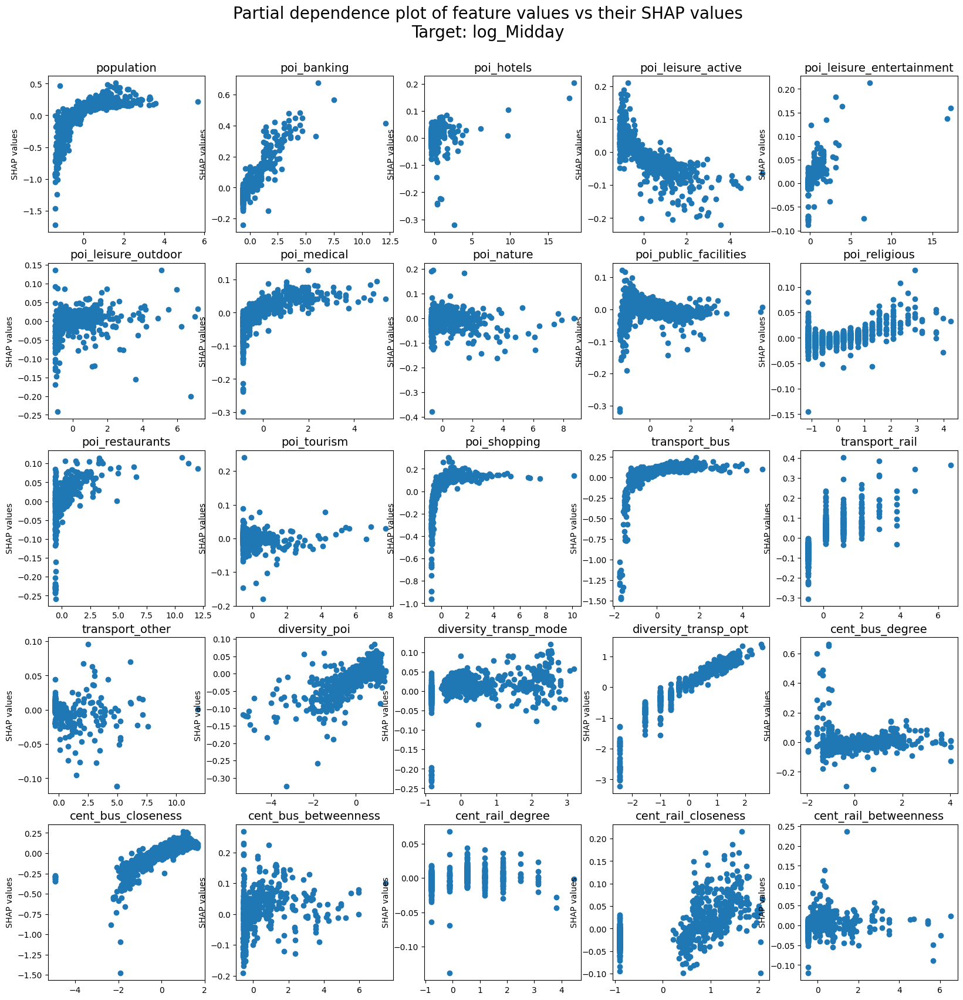

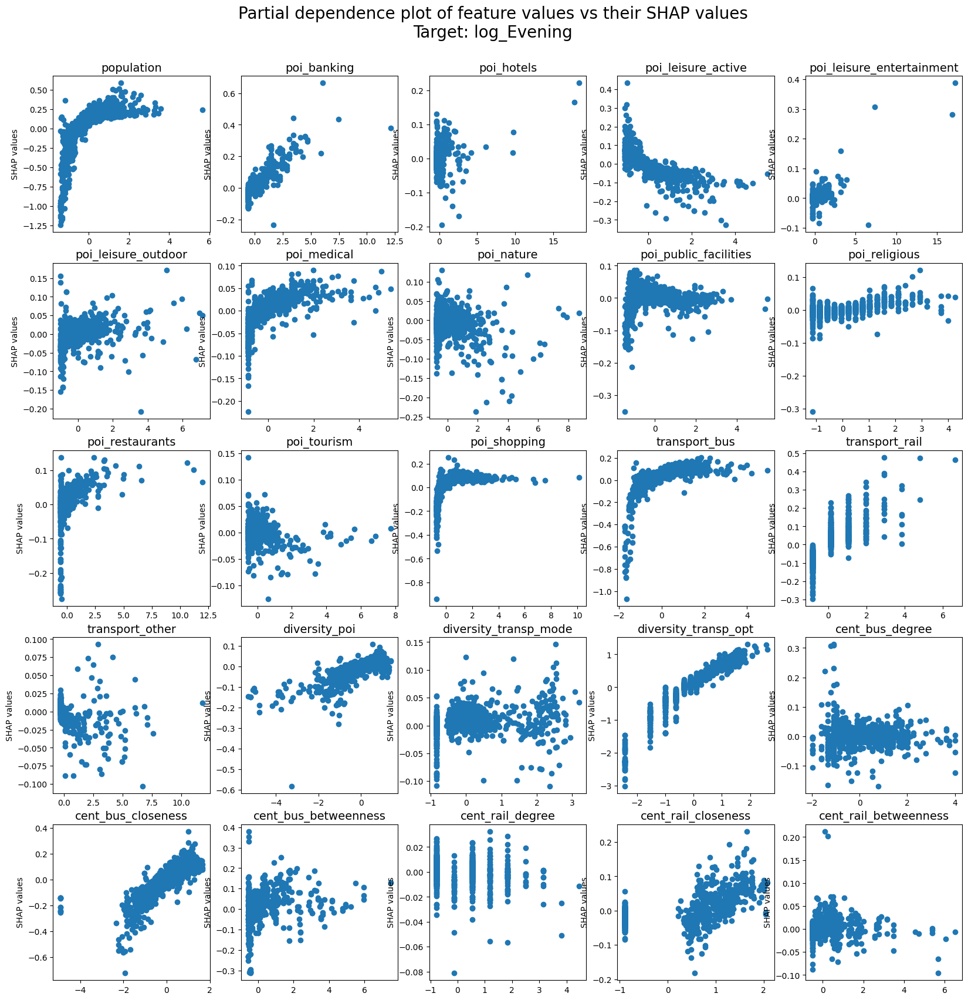

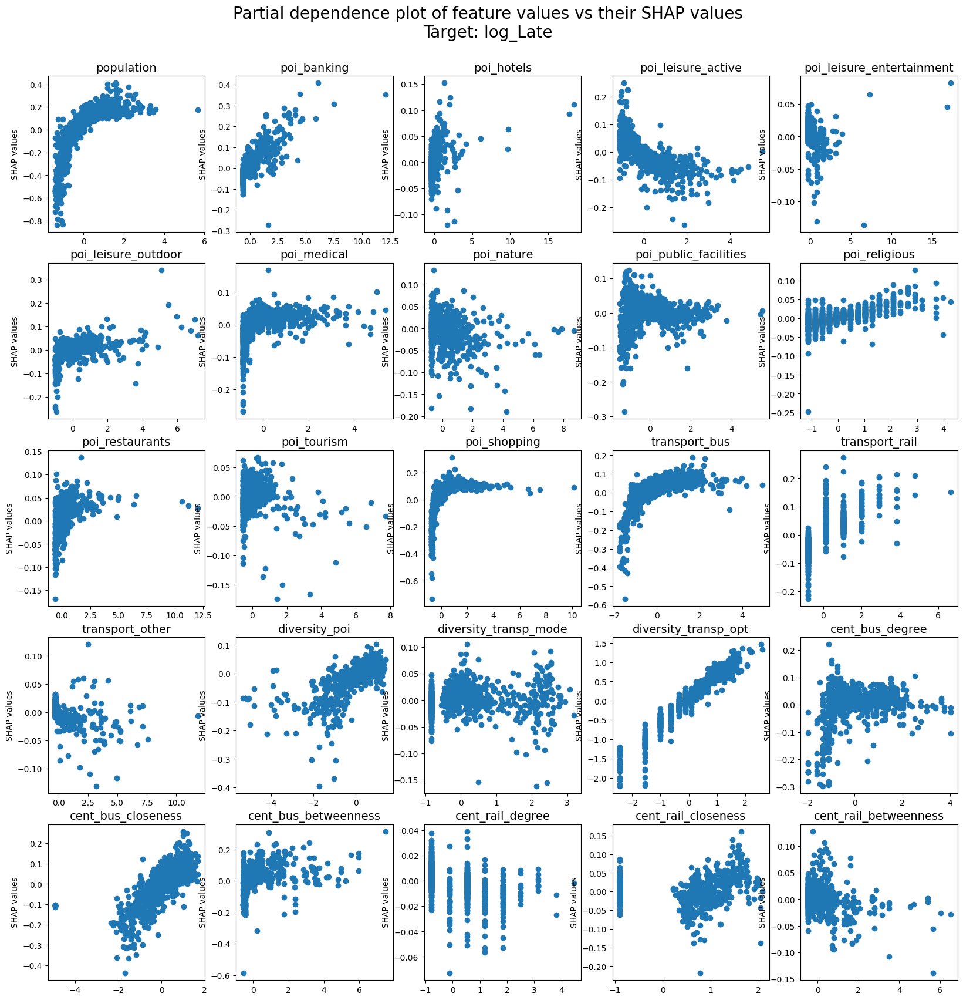

In [76]:
# Scatter Plot for all features
    
for target,shap_values in shap_list_.items():
    fig, ax = plt.subplots(5,5,figsize=(20,20))

    X_explain = pd.DataFrame(X, columns=features + [lags[targets_log.index(target)]])
    X_explain = X_explain.sample(1000, random_state=random_seed,axis=0)

    for j in range(25):
        ax = ax.ravel()
        ax[j].scatter(X_explain.iloc[:,j],shap_values.values[:,j])
        ax[j].set_title(features[j],fontsize=14)
        ax[j].set_ylabel('SHAP values')
    
    plt.suptitle(f'Partial dependence plot of feature values vs their SHAP values\nTarget: {target}', fontsize=20, y=0.94)
    plt.savefig(os.path.join('output','shap',f'shap_depplot_{target}.png'))
    plt.show()

## 4.2 Local (use shap_list)

In [12]:
# change df isochrones to points geometry for faster viz
df_point = df.copy()
df_point['geometry'] = [Point(x,y) for x,y in zip(df_point['x_coords'],df_point['y_coords'])]
df_point = gpd.GeoDataFrame(df_point, geometry='geometry', crs='EPSG:27700')

Plotting poi_leisure_entertainment... 5 of 25 features


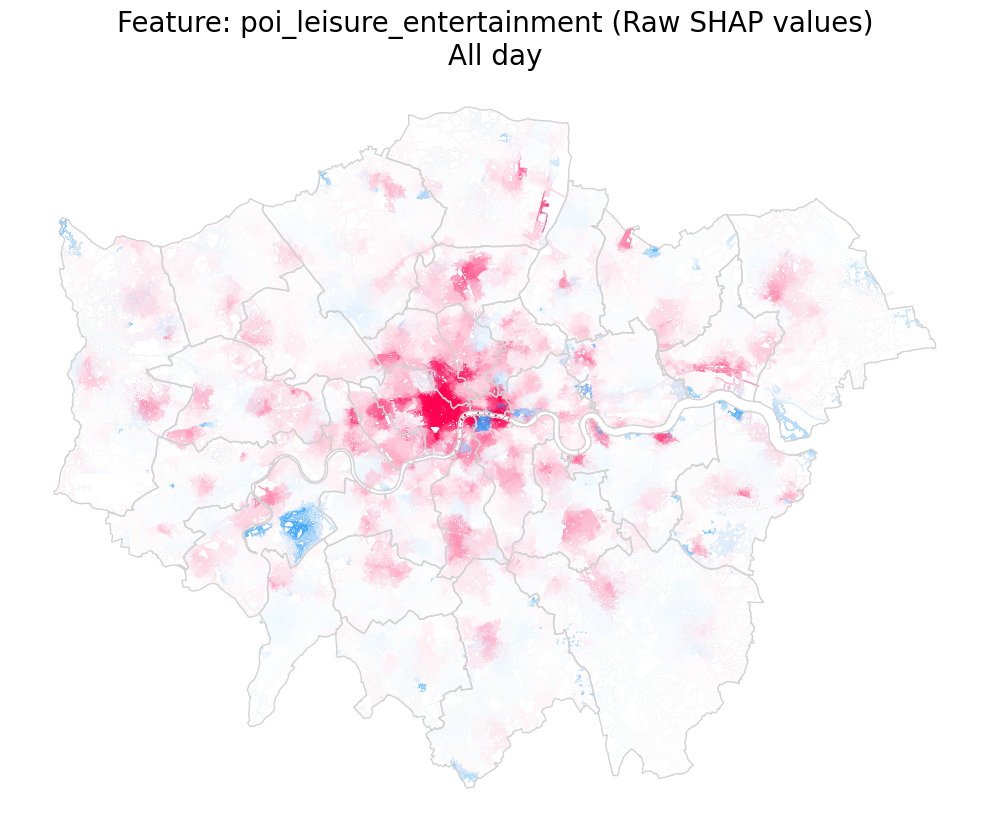

Plotting poi_leisure_outdoor... 6 of 25 features


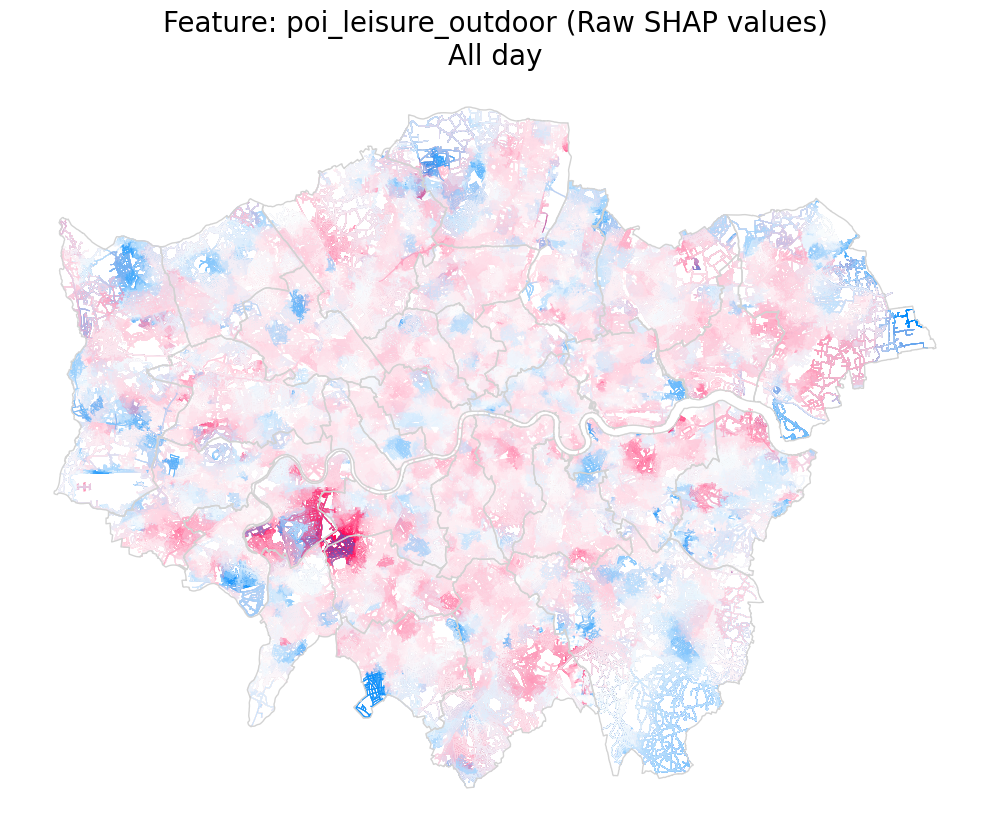

In [274]:
for j in range(2): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")

    fig, ax = plt.subplots(1,1,figsize=(10,10))
    target = 'log_Total'
    df.plot(ax=ax, 
                      column = shap_list[target].values[:,j],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.5, vmin=-0.1, vmax=0.1)
    ax.set_title(f'Feature: {features[j]} (Raw SHAP values)\nAll day',fontsize=20),
    ax.axis('off')
    boros.boundary.plot(ax=ax, color='lightgrey', linewidth=1)

    # plt.suptitle(f'Local SHAP values of feature: {features[j]}', fontsize=15, y=1.02)
    plt.tight_layout()      
    plt.savefig(os.path.join('output','shap',f'shap_isochronemap_{features[j]}_Total.jpg'))
    plt.show()

Plotting poi_leisure_entertainment... 5 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


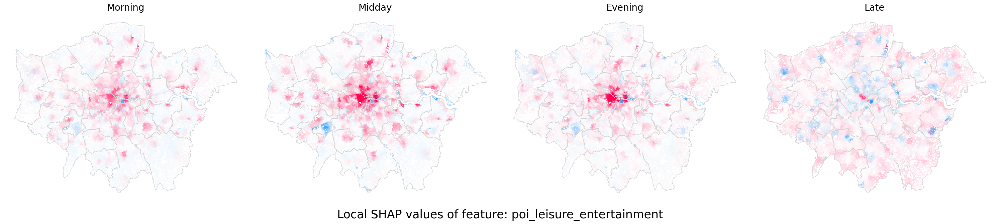

Plotting poi_leisure_outdoor... 6 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


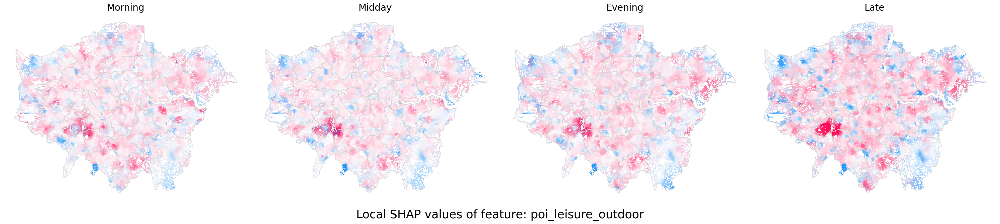

In [277]:
# plot the shap values on the map for each feature across all timebands
for j in range(2): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")
    
    fig, ax = plt.subplots(1,4,figsize=(30,30))
    ax = ax.flatten()
    for target,shap_values in shap_list.items(): # across all timebands
        
        # skip the target if it is log_Total
        if target == 'log_Total':
            continue
        
        print(f'{targets_log.index(target)} {target}')
        
        ax_plot = ax[targets_log.index(target)-1]

        df.plot(ax=ax_plot, 
                      column = shap_values.values[:,j],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.5,vmin=-0.1, vmax=0.1)
        ax_plot.set_title(f'{targets[targets_log.index(target)] }',fontsize=20),
        ax_plot.axis('off')
        boros.boundary.plot(ax=ax_plot, color='lightgrey', linewidth=1)


    plt.suptitle(f'Local SHAP values of feature: {features[j]}', fontsize=25, y=0.39)
    plt.tight_layout()      
    # plt.savefig(os.path.join('output','shap',f'shap_map_{features[j]}.jpg'))
    plt.show()

Plotting poi_leisure_entertainment... 5 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


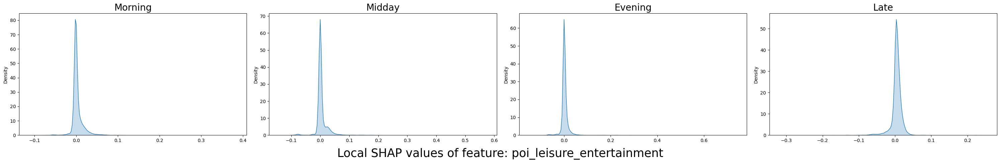

Plotting poi_leisure_outdoor... 6 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


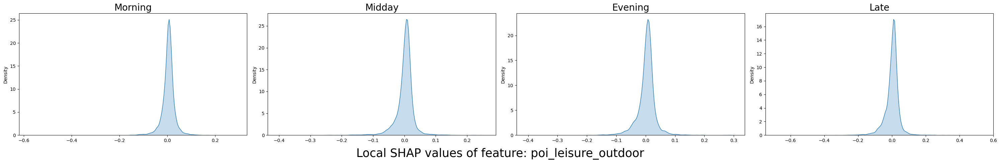

In [24]:
# plot the shap values on the map for each feature across all timebands
for j in range(2): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")
    
    fig, ax = plt.subplots(1,4,figsize=(30,5))
    ax = ax.flatten()
    for target,shap_values in shap_list.items(): # across all timebands
        
        # skip the target if it is log_Total
        if target == 'log_Total':
            continue
        
        print(f'{targets_log.index(target)} {target}')
        
        ax_plot = ax[targets_log.index(target)-1]
        # kde plot of the shap_values.values[:,j]
        sns.kdeplot(shap_values.values[:,j], ax=ax_plot, cmap='coolwarm', fill=True, thresh=False)
        ax_plot.set_title(f'{targets[targets_log.index(target)] }',fontsize=20)

    plt.suptitle(f'Local SHAP values of feature: {features[j]}', fontsize=25, y=0.0)
    plt.tight_layout()      
    plt.show()

## 4.3 Plot local examples
Local explanation for a few select isochrones: Kew gardens, Canary Wharf, Wembley, Covent Garden

In [ ]:
def plot_shap_iso(id):
    
    selected_iso = df.loc[id,'id_code']

    df_plot = df[df['id_code']==selected_iso]
    
    # Map isochrone location
    fig, ax = plt.subplots(1, 2)
    df_plot.plot(ax=ax[1], color='red', alpha=1)
    boros_plot = boros[boros.intersects(df_plot.geometry.values[0])]     # boro_plot from boros that intersects with selected isochrone
    boros_plot.boundary.plot(ax=ax[1], color='grey', linewidth=0.5)
    ax[1].axis('off')
    ax[1].set_title(f'Local SHAP values (All day)\nIsochrone {selected_iso}')

    # index for plotting
    idx = df.index[df['id_code'] == selected_iso].tolist()[0]
    
    # plot Total
    shap_values = shap_list['log_Total']
    plt.sca(ax[0])
    shap.plots.waterfall(shap_values[idx], max_display=20,show=False)
    plt.subplots_adjust(left=0.05, right=1, top=0.90, bottom=0.05)
    plt.show()
    
    # plot other timebands
    fig, ax = plt.subplots(1, 4, figsize=(10, 30))
    for i,target in enumerate(targets_log[1:]):
        shap_values = shap_list[target]
        fig.sca(ax[i])
        shap.plots.waterfall(shap_values[idx], max_display=20,show=False)
        ax[i].set_title(f'{targets[targets_log.index(target)]}',fontsize=15)
        plt.xticks(fontsize=5)
    plt.subplots_adjust(left=0.05, right=4, top=0.90, bottom=0.05)
    plt.suptitle(f'Local SHAP values by time band (Isochrone {selected_iso})', fontsize=20)
    plt.show()

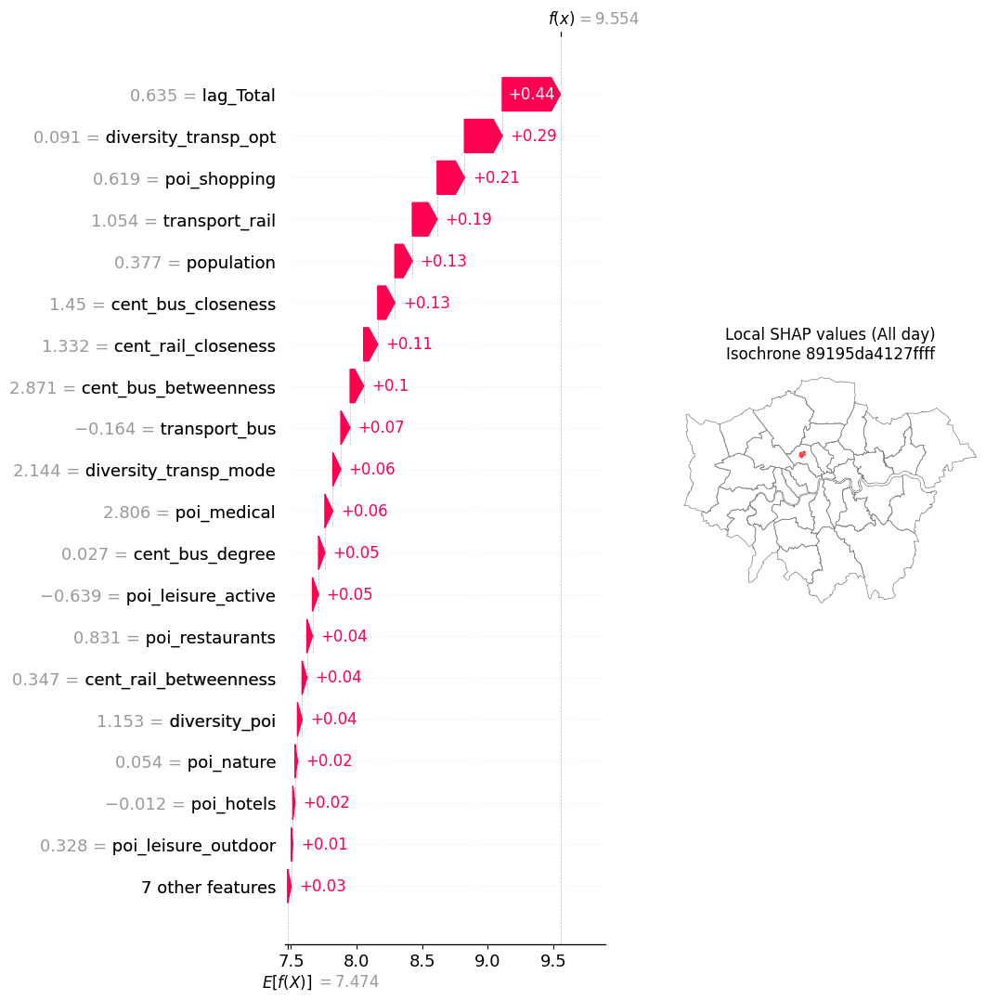

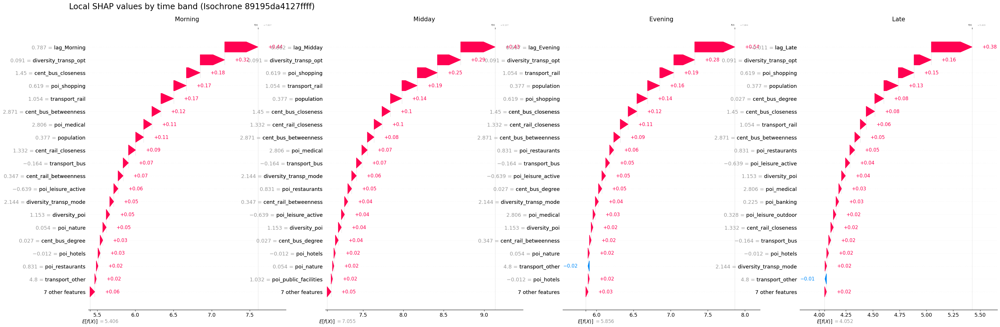

In [242]:
plot_shap_iso(4520) # Hampstead Heath

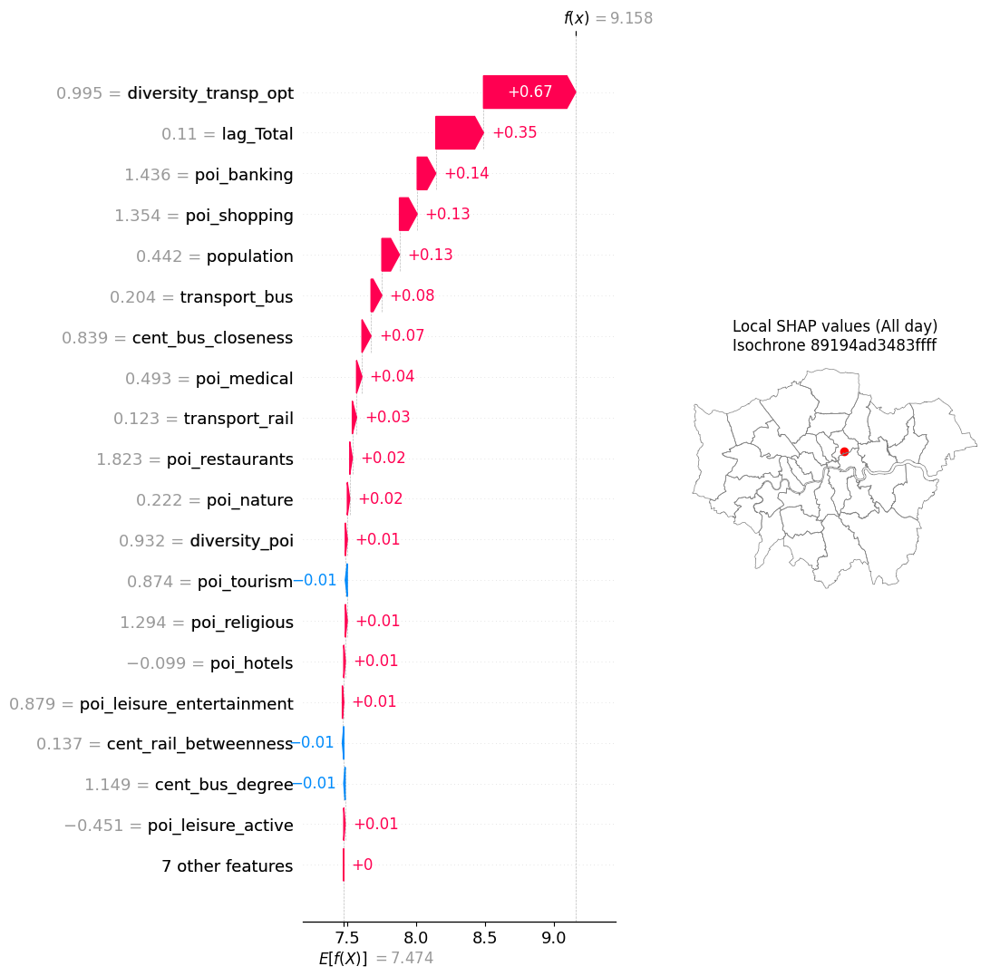

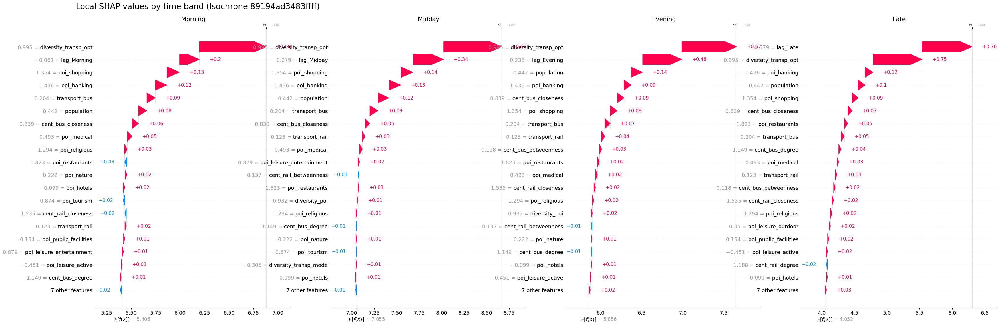

In [420]:
plot_shap_iso(16519) # Hackney

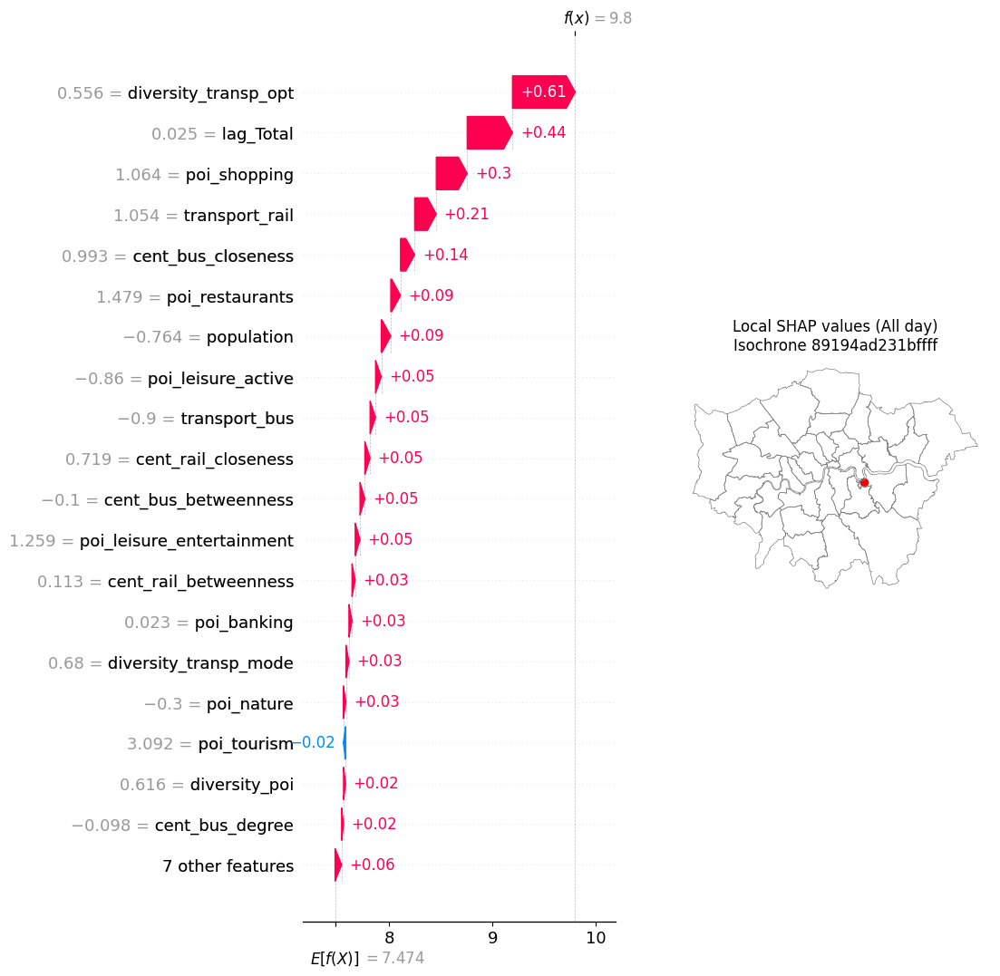

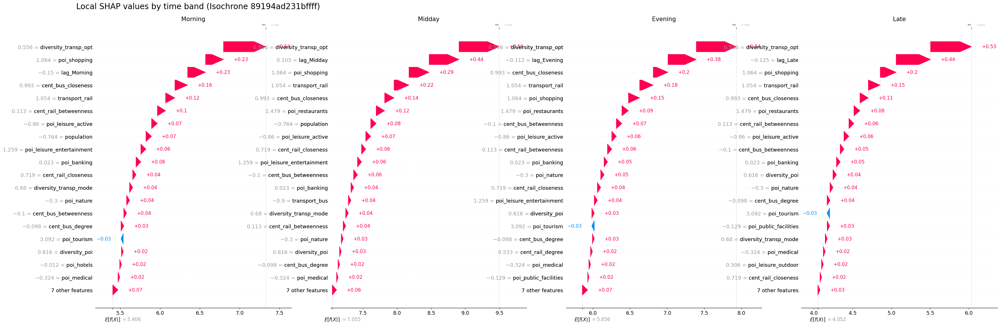

In [417]:
plot_shap_iso(4507) # Greenwich Village

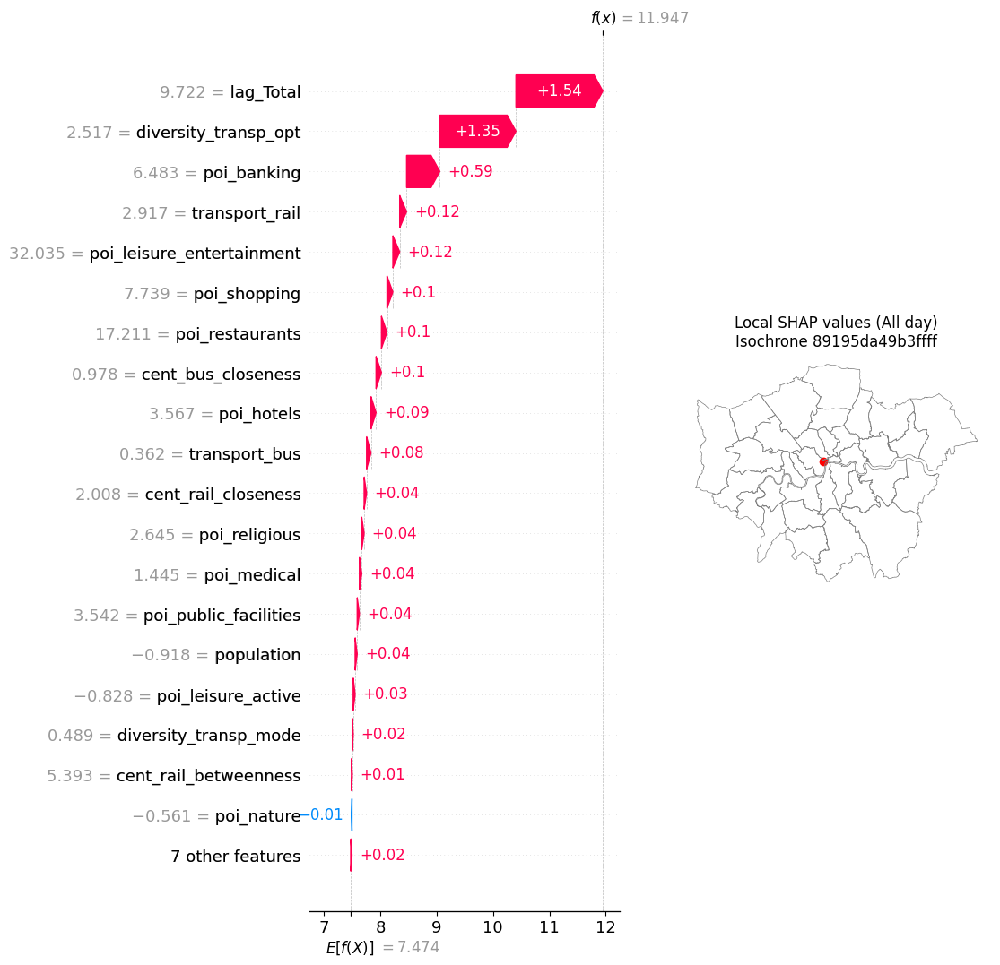

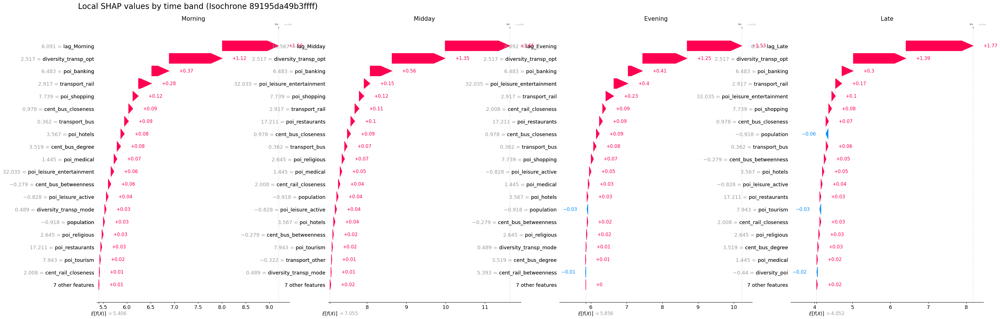

In [415]:
plot_shap_iso(3908) # Covent Garden/Leicester Square

## 4.4 Save raw SHAP

In [7]:
# change shap_list[target].values to 5 dataframes for 5 timebands

shap_list_df = {}
for target,shap_values in shap_list.items():
    shap_list_df[target] = pd.DataFrame(shap_values.values, columns=features + [lags[targets_log.index(target)]])
    shap_list_df[target]['id_code'] = df['id_code']
    shap_list_df[target].to_csv(os.path.join('data','cleaned',f'final_shap_values_{target}_1907.csv'), index=False)
shap_list_df.keys() # containing 5 dataframes of local shap_values

dict_keys(['log_Total', 'log_Morning', 'log_Midday', 'log_Evening', 'log_Late'])

In [8]:
# save geo data
df_geo = df[['id_code','geometry','x_coords','y_coords']]
# df_geo.to_csv(os.path.join('data','cleaned','final_shap_geo.csv'), index=False)

# Weighted local SHAP

## 1 Calc and save weighted SHAP

In [9]:
# calculate the weighted shap values (by diversity_poi) -> array
shap_list_wdiv = {}
for target,shap_values in shap_list.items():

    # get the diversitay_poi values from df
    div_poi = df['diversity_poi']
    div_poi = div_poi.values[:,np.newaxis]

    # multiply shap_values by div_poi (penalise areas with low diversity, low entropy)
    shap_values_weighted = shap_values.values * div_poi
    shap_list_wdiv[target] = shap_values_weighted
 
# convert and save shap_list_w as 5 csv, no geo
shap_list_wdiv_df = {}
for target,shap_values in shap_list_wdiv.items():
    shap_list_wdiv_df[target] = pd.DataFrame(shap_values, columns=features + [lags[targets_log.index(target)]])
    shap_list_wdiv_df[target]['id_code'] = df['id_code']
    shap_list_wdiv_df[target].to_csv(os.path.join('data','cleaned',f'final_shap_values_wdiv_{target}_1907.csv'), index=False)
shap_list_wdiv_df.keys()

dict_keys(['log_Total', 'log_Morning', 'log_Midday', 'log_Evening', 'log_Late'])

In [10]:
# calculate the weighted shap values (by diversity_poi and div_transp_opt) -> array
shap_list_wwdiv = {}
for target,shap_values in shap_list.items():

    # get the diversitay_poi values from df
    centrality_transp = df['cent_bus_closeness'] + df['cent_rail_closeness']
    centrality_transp = centrality_transp + 1e-6 # to avoid division by zero

    # multiply shap_values by div_poi (penalise areas with low diversity, low entropy) divided by by predicted y
    shap_values_weighted = shap_values.values / centrality_transp.values[:,np.newaxis]
    shap_list_wwdiv[target] = shap_values_weighted
    
# convert and save shap_list_w as 5 csv, no geo
shap_list_wwdiv_df = {}
for target,shap_values in shap_list_wdiv.items():
    shap_list_wwdiv_df[target] = pd.DataFrame(shap_values, columns=features + [lags[targets_log.index(target)]])
    shap_list_wwdiv_df[target]['id_code'] = df['id_code']
    shap_list_wwdiv_df[target].to_csv(os.path.join('data','cleaned',f'final_shap_values_wwdiv_{target}_1907.csv'), index=False)
shap_list_wwdiv_df.keys()

dict_keys(['log_Total', 'log_Morning', 'log_Midday', 'log_Evening', 'log_Late'])

In [11]:
# calculate the weighted shap values (by diversity_poi and div_transp_opt) -> array
shap_list_wwwdiv = {}
for target,shap_values in shap_list.items():

    # divide shap by target
    # if df[target] is 0, shap_values_weighted will be 0, otherwise shap_values_weighted will be shap_values / df[target]
    

    denom = df[target].values
    # change 0 to 1e100
    denom[denom==0] = 1e100
    shap_values_weighted = shap_values.values / denom[:,np.newaxis]
  
    # shap_values_weighted = shap_values / df[target].values[:,np.newaxis]
    shap_list_wwwdiv[target] = shap_values_weighted
    
# convert and save shap_list_w as 5 csv, no geo
shap_list_wwwdiv_df = {}
for target,shap_values in shap_list_wdiv.items():
    shap_list_wwwdiv_df[target] = pd.DataFrame(shap_values, columns=features + [lags[targets_log.index(target)]])
    shap_list_wwwdiv_df[target]['id_code'] = df['id_code']
    shap_list_wwwdiv_df[target].to_csv(os.path.join('data','cleaned',f'final_shap_values_wwwdiv_{target}_1907.csv'), index=False)
shap_list_wwwdiv_df.keys()

dict_keys(['log_Total', 'log_Morning', 'log_Midday', 'log_Evening', 'log_Late'])

## 2 Plot local SHAP (weighted)

Plotting poi_leisure_entertainment... 5 of 25 features


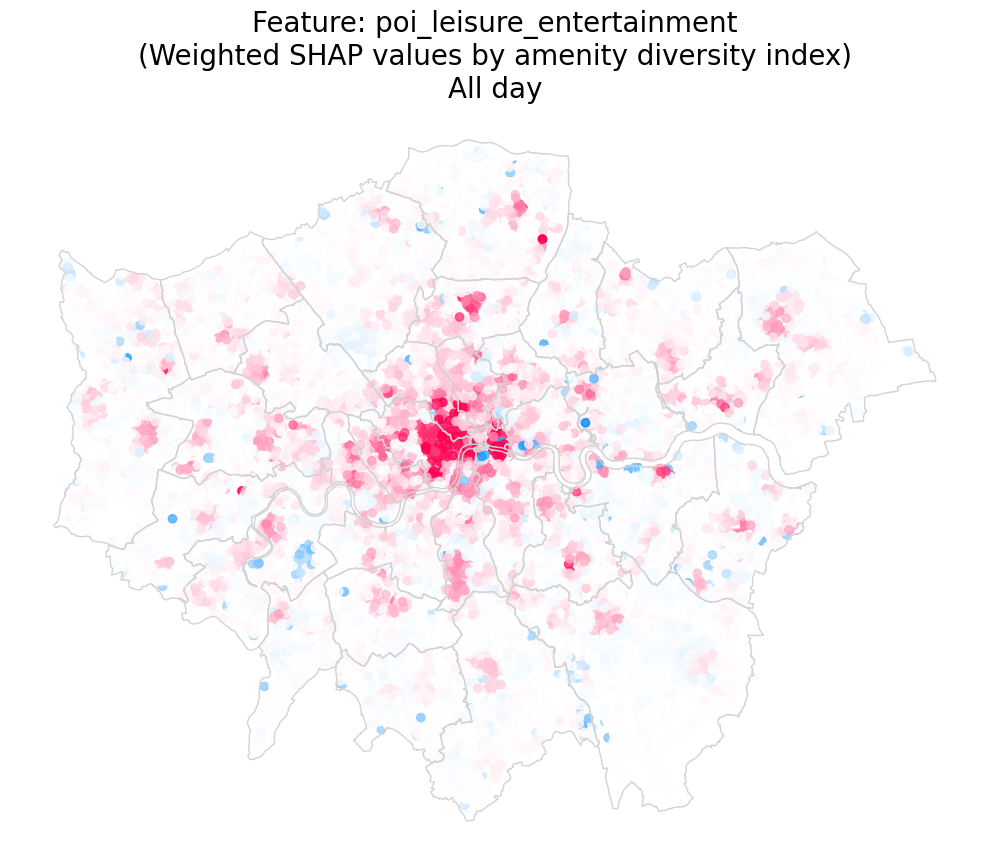

Plotting poi_leisure_outdoor... 6 of 25 features


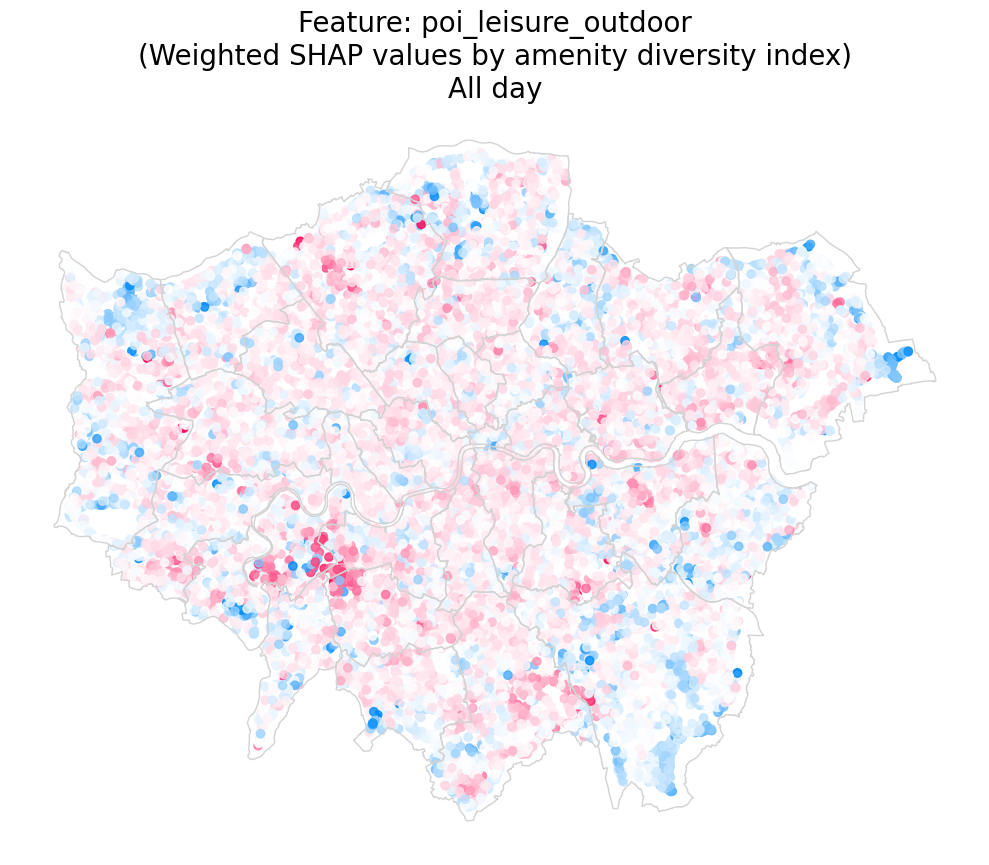

In [267]:
# plot the shap values on the map for each feature across all timebands
for j in range(2): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")

    fig, ax = plt.subplots(1,1,figsize=(10,10))
    target = 'log_Total'
    df_point.plot(ax=ax, 
                      column = shap_list_wdiv[target][:,j],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.8, vmin=-0.1, vmax=0.1)

    ax.set_title(f'Feature: {features[j]}\n(Weighted SHAP values by amenity diversity index)\nAll day',fontsize=20),
    ax.axis('off')
    boros.boundary.plot(ax=ax, color='lightgrey', linewidth=1)

    # plt.suptitle(f'Local SHAP values of feature: {features[j]}', fontsize=15, y=1.02)
    plt.tight_layout()      
    # plt.savefig(os.path.join('output','shap',f'shap_isochronemap_weighted_{features[j]}_Total.jpg'))
    plt.show()

Plotting poi_leisure_entertainment... 5 of 25 features


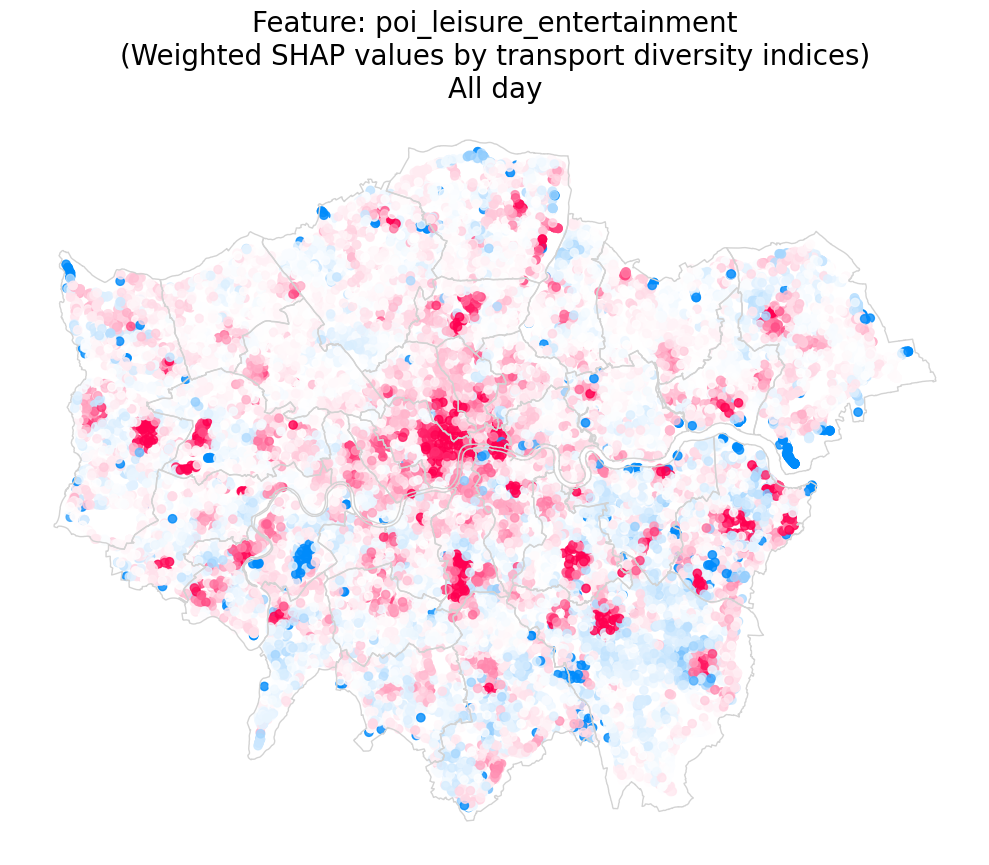

Plotting poi_leisure_outdoor... 6 of 25 features


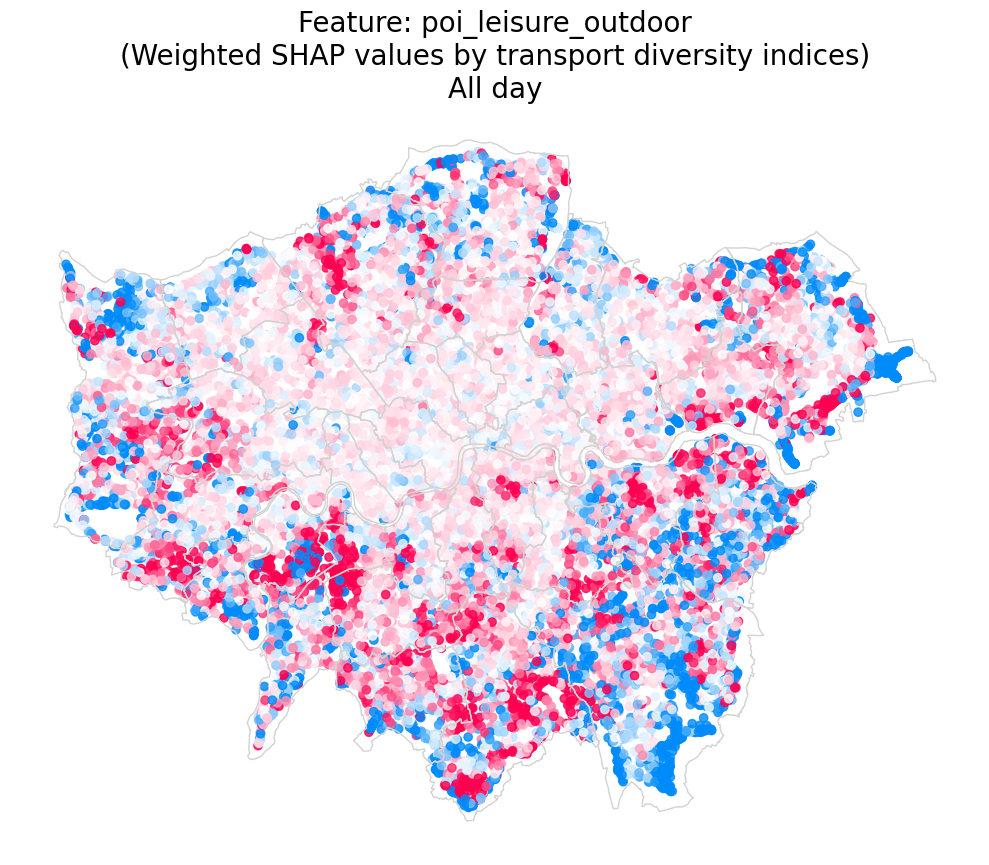

In [62]:
# plot the shap values on the map for each feature across all timebands
for j in range(len(features[4:6])): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")

    fig, ax = plt.subplots(1,1,figsize=(10,10))
    target = 'log_Total'
    df_point.plot(ax=ax, 
                      column = shap_list_wwdiv[target][:,j],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.8, vmin=-0.75, vmax=0.75)

    ax.set_title(f'Feature: {features[j]}\n(Weighted SHAP values by transport diversity indices)\nAll day',fontsize=20),
    ax.axis('off')
    boros.boundary.plot(ax=ax, color='lightgrey', linewidth=1)

    # plt.suptitle(f'Local SHAP values of feature: {features[j]}', fontsize=15, y=1.02)
    plt.tight_layout()      
    # plt.savefig(os.path.join('output','shap',f'shap_isochronemap_weighted_{features[j]}_Total.jpg'))
    plt.show()

Plotting poi_leisure_entertainment... 5 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


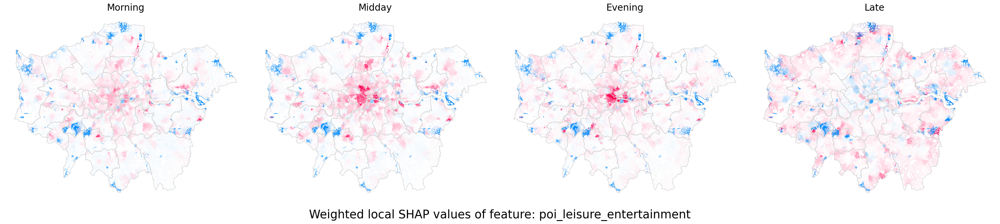

Plotting poi_leisure_outdoor... 6 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


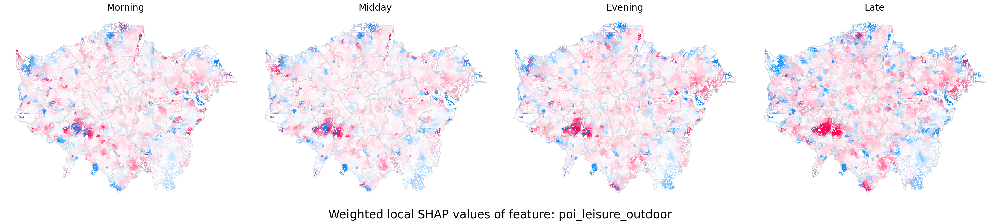

In [35]:
# plot the shap values on the map for each feature across all timebands
for j in range(2): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")
    
    fig, ax = plt.subplots(1,4,figsize=(30,30))
    ax = ax.flatten()

    for target,shap_values in shap_list_wwdiv.items(): # across all timebands
        
        # skip the target if it is log_Total
        if target == 'log_Total':
            continue
        
        print(f'{targets_log.index(target)} {target}')
        
        ax_plot = ax[targets_log.index(target)-1]

        df.plot(ax=ax_plot, 
                      column = shap_values[:,j],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.8,
                      vmin=-0.2, vmax=0.2)
                      
        ax_plot.set_title(f'{targets[targets_log.index(target)]}',fontsize=20),
        ax_plot.axis('off')
        boros.boundary.plot(ax=ax_plot, color='lightgrey', linewidth=1)

    plt.suptitle(f'Weighted local SHAP values of feature: {features[j]}', fontsize=25, y=0.39)
    plt.tight_layout()      
    # plt.savefig(os.path.join('output','shap',f'shap_map_weighted_{features[j]}.jpg'))
    plt.show()

Plotting poi_leisure_entertainment... 5 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


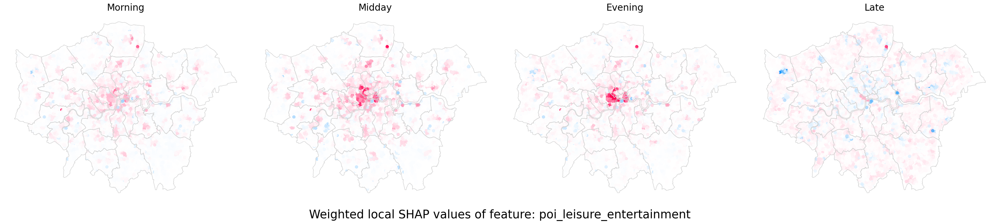

Plotting poi_leisure_outdoor... 6 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


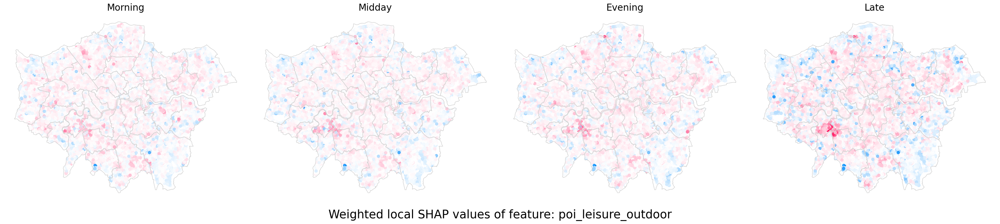

In [36]:
# plot the shap values on the map for each feature across all timebands
for j in range(2): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")
    
    fig, ax = plt.subplots(1,4,figsize=(30,30))
    ax = ax.flatten()

    for target,shap_values in shap_list_wdiv.items(): # across all timebands
        
        # skip the target if it is log_Total
        if target == 'log_Total':
            continue
        
        print(f'{targets_log.index(target)} {target}')
        
        ax_plot = ax[targets_log.index(target)-1]

        df_point.plot(ax=ax_plot, 
                      column = shap_values[:,j],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.8,
                      vmin=-0.2, vmax=0.2)
                      
        ax_plot.set_title(f'{targets[targets_log.index(target)]}',fontsize=20),
        ax_plot.axis('off')
        boros.boundary.plot(ax=ax_plot, color='lightgrey', linewidth=1)

    plt.suptitle(f'Weighted local SHAP values of feature: {features[j]}', fontsize=25, y=0.39)
    plt.tight_layout()      
    # plt.savefig(os.path.join('output','shap',f'shap_map_weighted_{features[j]}.jpg'))
    plt.show()

Plotting poi_leisure_entertainment... 5 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


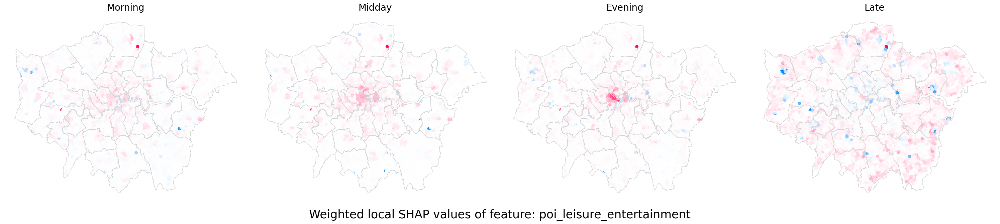

Plotting poi_leisure_outdoor... 6 of 25 features
1 log_Morning
2 log_Midday
3 log_Evening
4 log_Late


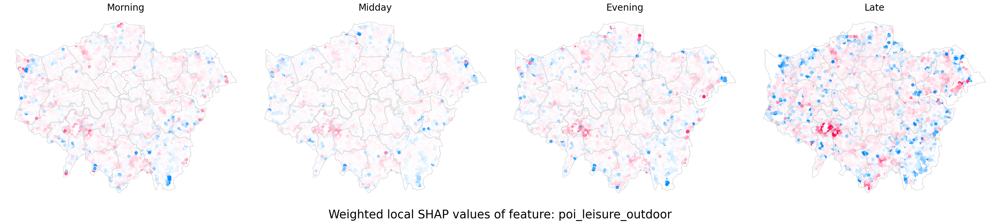

In [42]:
# plot the shap values on the map for each feature across all timebands
for j in range(2): # across all features
    j=j+4
    print(f"Plotting {features[j]}... {j+1} of {len(features)} features")
    
    fig, ax = plt.subplots(1,4,figsize=(30,30))
    ax = ax.flatten()

    for target,shap_values in shap_list_wwwdiv.items(): # across all timebands
        
        # skip the target if it is log_Total
        if target == 'log_Total':
            continue
        
        print(f'{targets_log.index(target)} {target}')
        
        ax_plot = ax[targets_log.index(target)-1]

        df_point.plot(ax=ax_plot, 
                      column = shap_values[:,j],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.8,
                      vmin=-0.05, vmax=0.05)
                      
        ax_plot.set_title(f'{targets[targets_log.index(target)]}',fontsize=20),
        ax_plot.axis('off')
        boros.boundary.plot(ax=ax_plot, color='lightgrey', linewidth=1)

    plt.suptitle(f'Weighted local SHAP values of feature: {features[j]}', fontsize=25, y=0.39)
    plt.tight_layout()      
    # plt.savefig(os.path.join('output','shap',f'shap_map_weighted_{features[j]}.jpg'))
    plt.show()

## 3 Calc and plot activity centers 
(High POI contribution)

Plotting activity/transport centre - log_Total...


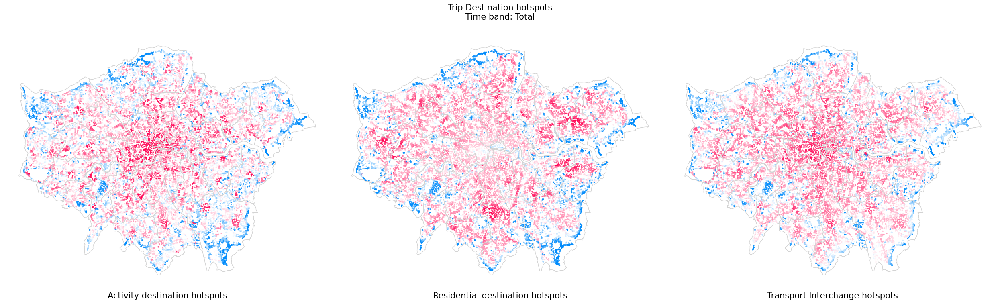

Plotting activity/transport centre - log_Morning...


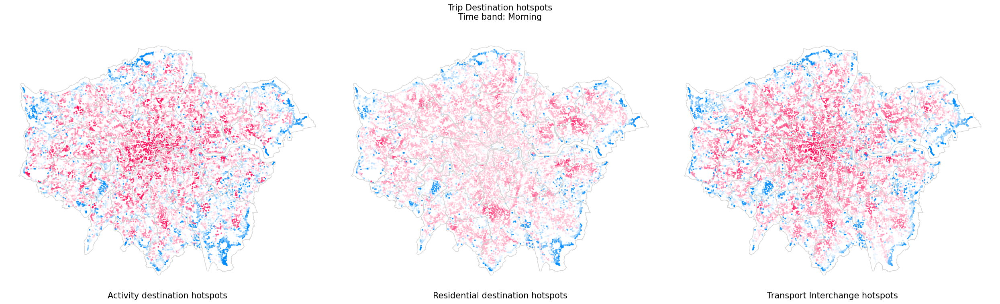

Plotting activity/transport centre - log_Midday...


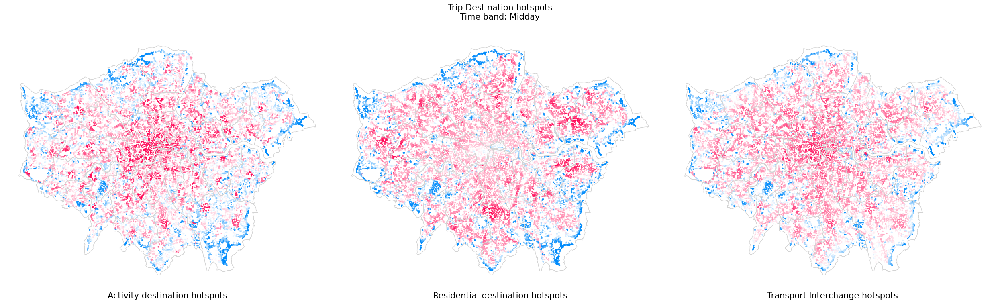

Plotting activity/transport centre - log_Evening...


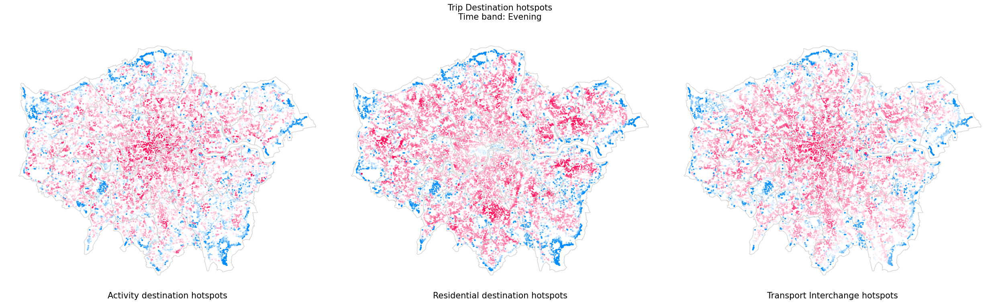

Plotting activity/transport centre - log_Late...


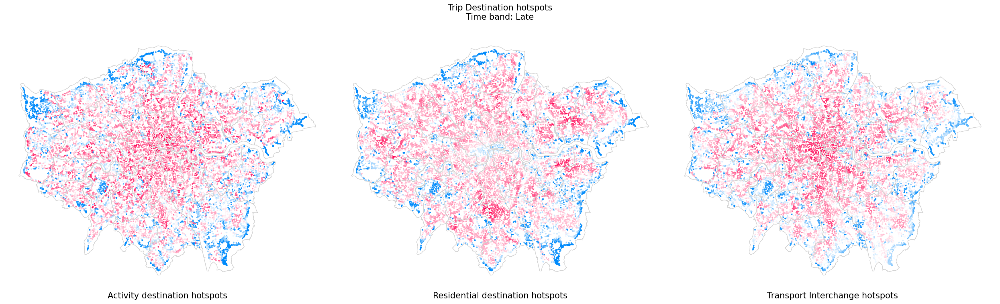

In [21]:
for target,shap_df in shap_list_df.items():
    
    # sum of all colunmn with poi and population
    shap_df['activity_hotspot'] = shap_df.filter(regex='poi').sum(axis=1)

    # # sum of all colunmn with transp
    shap_df['transit_hotspot'] = shap_df.filter(regex='transp').sum(axis=1)

    vmin = -0.7
    vmax = 0.7

    print(f"Plotting activity/transport centre - {target}...")
    fig, ax = plt.subplots(1,3,figsize=(25,10))
    df_point.plot(ax=ax[0], 
                      column = shap_df['activity_hotspot'],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.8, vmin=vmin, vmax=vmax, markersize=3)
    ax[0].set_title(f'Activity destination hotspots',fontsize=15, y=-0.06)

    df_point.plot(ax=ax[1], 
                      column = shap_df['population'],
                      cmap=shap.plots.colors.red_white_blue,
                      alpha=0.8, vmin=vmin+0.3, vmax=vmax-0.3, markersize=3)
    # title underneath the figure
    ax[1].set_title(f'Residential destination hotspots',fontsize=15, y=-0.06)

    df_point.plot(ax=ax[2],
                    column = shap_df['transit_hotspot'],
                    cmap=shap.plots.colors.red_white_blue,
                    alpha=0.8, vmin=vmin-1, vmax=vmax+1, markersize=3)
    ax[2].set_title(f'Transport Interchange hotspots',fontsize=15, y=-0.06)       

    for a in ax:
        boros.boundary.plot(ax=a, color='lightgrey', linewidth=1)
        a.axis('off')

    # decrease the space between the plots
    plt.tight_layout()

    plt.suptitle(f'Trip Destination hotspots\nTime band: {targets[targets_log.index(target)]}', fontsize=15, y=0.89)
    plt.savefig(os.path.join('output','shap',f'shap_hotspots_{target}.jpg'))
    plt.show()


# Clustering

Cluster POI Leisure entertainment hotspot

In [13]:
def hotspot_cluster(dict,chosen_poi,chosen_timeband,min_clus):

    # prep
    df_cluster = dict[chosen_timeband].copy()
    df_cluster_ = df_geo.merge(df_cluster[['id_code',chosen_poi]], on='id_code', how='left') # isochrone
    # change geometry to point from x_coords and y_coords
    df_cluster_geo = df_cluster_.copy()
    df_cluster_geo['geometry'] = [Point(x,y) for x,y in zip(df_cluster_geo['x_coords'],df_cluster_geo['y_coords'])]
    df_cluster_geo = gpd.GeoDataFrame(df_cluster_geo, geometry='geometry', crs='EPSG:27700')

    # prepare feature matrixc for clustering
    coords = np.column_stack([df_cluster_geo['x_coords'],df_cluster_geo['y_coords']])
    attribute = df_cluster_geo[chosen_poi].values.reshape(-1,1)                    
    X = np.hstack([coords,attribute])

    # cluster
    clusterer = HDBSCAN(min_cluster_size=min_clus, min_samples=1)
    cluster_labels = clusterer.fit_predict(X)
    df_cluster_['activity_cluster'] = cluster_labels
    df_cluster_geo['activity_cluster'] = cluster_labels
    print(f"Number of clusters: {len(df_cluster_geo['activity_cluster'].unique())}")
    print(f"Outliers: {len(df_cluster_geo[df_cluster_geo['activity_cluster']==-1])}")


    # calculate mean activity_hotspot for each cluster
    df_grouped = df_cluster_.groupby('activity_cluster').agg({chosen_poi:'mean'})
    df_grouped.rename(columns={chosen_poi:f'mean_{chosen_poi}'},inplace=True)
    df_grouped.reset_index(inplace=True)
    

    # merge geometry of rows in the same cluster, and get mean of chosen_poi
    df_plot = df_cluster_.dissolve('activity_cluster').reset_index() # dissolve to get one polygon per cluster
    df_plot.drop(columns=[chosen_poi],inplace=True) # remove original column (cleanup)
    df_plot = df_plot.merge(df_grouped, on='activity_cluster', how='left') # merge with mean of chosen_poi
    df_plot = df_plot[df_plot[f'mean_{chosen_poi}'] > 0] # remove neg mean, (negative SHAP)
    df_plot = df_plot[df_plot['activity_cluster']!=-1] # remove outliers cluster

    return df_plot
# df_plot is the geodataframe for the clusters dissolved

In [14]:
def hotspot_member(dict,chosen_poi,chosen_timeband,min_clus):

    # prep
    df_cluster = dict[chosen_timeband].copy()
    df_cluster_ = df_geo.merge(df_cluster[['id_code',chosen_poi]], on='id_code', how='left') # isochrone
    # change geometry to point from x_coords and y_coords
    df_cluster_geo = df_cluster_.copy()
    df_cluster_geo['geometry'] = [Point(x,y) for x,y in zip(df_cluster_geo['x_coords'],df_cluster_geo['y_coords'])]
    df_cluster_geo = gpd.GeoDataFrame(df_cluster_geo, geometry='geometry', crs='EPSG:27700')

    # prepare feature matrixc for clustering
    coords = np.column_stack([df_cluster_geo['x_coords'],df_cluster_geo['y_coords']])
    attribute = df_cluster_geo[chosen_poi].values.reshape(-1,1)                    
    X = np.hstack([coords,attribute])

    # cluster
    clusterer = HDBSCAN(min_cluster_size=min_clus, min_samples=1)
    cluster_labels = clusterer.fit_predict(X)
    df_cluster_['activity_cluster'] = cluster_labels
    df_cluster_geo['activity_cluster'] = cluster_labels
    print(f"Number of clusters: {len(df_cluster_geo['activity_cluster'].unique())}")
    print(f"Outliers: {len(df_cluster_geo[df_cluster_geo['activity_cluster']==-1])}")
    
    return df_cluster_geo
# df_cluster_geo is the geodataframe for the isochrones with cluster labels


In [15]:
# %%time

# df_clus_activity = hotspot_cluster(shap_list_df,'activity_hotspot','log_Total',3)
# df_clus_transport = hotspot_cluster(shap_list_df,'transit_hotspot','log_Total',3)
# df_clus_residential = hotspot_cluster(shap_list_df,'population','log_Total',3)

# df_clus_activity.to_file(os.path.join('data','cleaned','final_clusters_activity.geojson'), driver='GeoJSON')
# df_clus_transport.to_file(os.path.join('data','cleaned','final_clusters_transport.geojson'), driver='GeoJSON')
# df_clus_residential.to_file(os.path.join('data','cleaned','final_clusters_residential.geojson'), driver='GeoJSON')

In [24]:
df_clus_activity = gpd.read_file(os.path.join('data','cleaned','final_clusters_activity.geojson'))
df_mem_activity = hotspot_member(shap_list_df,'activity_hotspot','log_Total',3)

# df_clus_transport = gpd.read_file(os.path.join('data','cleaned','final_clusters_transport.geojson'))
# df_mem_transport = hotspot_member(shap_list_df,'transit_hotspot','log_Total',3)

# df_clus_residential = gpd.read_file(os.path.join('data','cleaned','final_clusters_residential.geojson'))
# df_mem_residential = hotspot_member(shap_list_df,'population','log_Total',3)

Number of clusters: 2672
Outliers: 2533
CPU times: total: 1min 31s
Wall time: 3min 7s


Wood Green

In [17]:
def create_buffered_point(longitude, latitude):
    """
    Creates a GeoDataFrame containing a point geometry, transformed to the target CRS, and buffered by the given distance.

    Args:
        longitude: The longitude of the point.
        latitude: The latitude of the point.
        buffer_distance: The buffer distance in the units of the target CRS.
        target_crs: The target CRS (default is 27700).

    Returns:
        gpd.GeoDataFrame: A GeoDataFrame with a buffered point geometry.
    """

    point = Point(longitude, latitude)
    gdf_point = gpd.GeoDataFrame({'geometry': [point]}, crs="EPSG:4326")
    gdf_point = gdf_point.to_crs(27700)
    gdf_buffer = gpd.GeoDataFrame(geometry=gdf_point.buffer(100))
    return gdf_buffer

In [117]:
def plot_max_activity_cluster(df_clus,df_mem,point_buffer):
    """
    Plots the activity cluster with maximum mean activity and its member spatial units.
    
    Args:
        point_buffer: GeoDataFrame containing the buffered point geometry.
    """

    # Filter cluster intersecting the buffer
    df_area = df_clus[df_clus.intersects(point_buffer.geometry[0])]
    df_area.loc[:, 'activity_cluster'] = df_area['activity_cluster'].astype('category')

    # Find cluster with max mean activity
    max_cluster = df_area.loc[df_area['mean_activity_hotspot'].idxmax(), 'activity_cluster']
    df_clus_filter = df_clus[df_clus['activity_cluster'] == max_cluster]
    df_mem_filter = df_mem[df_mem['activity_cluster'] == max_cluster]

    # Plot
    fig, ax = plt.subplots(1, 2, figsize=(8, 5), sharex=True, sharey=True)

    df_clus_filter.plot(ax=ax[0], alpha=0.5, cmap='viridis')
    point_buffer.plot(ax=ax[0], color='red', alpha=0.5)

    df_mem_filter.plot(ax=ax[1], alpha=0.5, column='id_code', legend=True, legend_kwds={
        'loc': 'lower left', 
        'title': 'Centroids of spatial units',
        'title_fontsize': 8,
        'fontsize': 6,
        'shadow': True,
        'markerscale': 0.5,
        'ncol': 2,   
        'bbox_to_anchor': (0.05, 0.05),
        
        })

    for i in range(2):
        ctx.add_basemap(ax[i], crs=27700, source=ctx.providers.CartoDB.Positron)
        ax[i].axis('off')

    plt.tight_layout()
    plt.show()

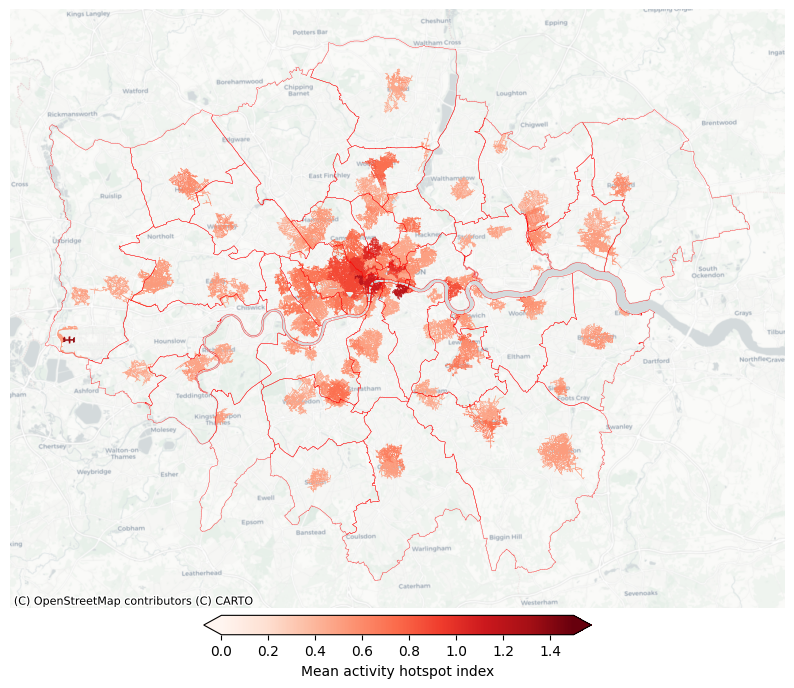

In [124]:
# Mapping df_clus_activity
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# top 10%
threshold = np.percentile(df_clus_activity['mean_activity_hotspot'],90)

df_clus_activity[df_clus_activity['mean_activity_hotspot']>=threshold].plot(
    column='mean_activity_hotspot', 
    cmap='Reds', 
    legend=True, 
    ax=ax,
    vmin = 0, vmax = 1.5,
    legend_kwds={
        'label': "Mean activity hotspot index",
        'orientation': "horizontal",
        'shrink': 0.5,
        'pad': 0.01,
        'extend': 'both',
    }
    )
boros.boundary.plot(ax=ax, color='red', linewidth=0.25)
ctx.add_basemap(ax=ax, crs=27700, source=ctx.providers.CartoDB.Positron, zoom=11)

ax.axis('off')

plt.show()

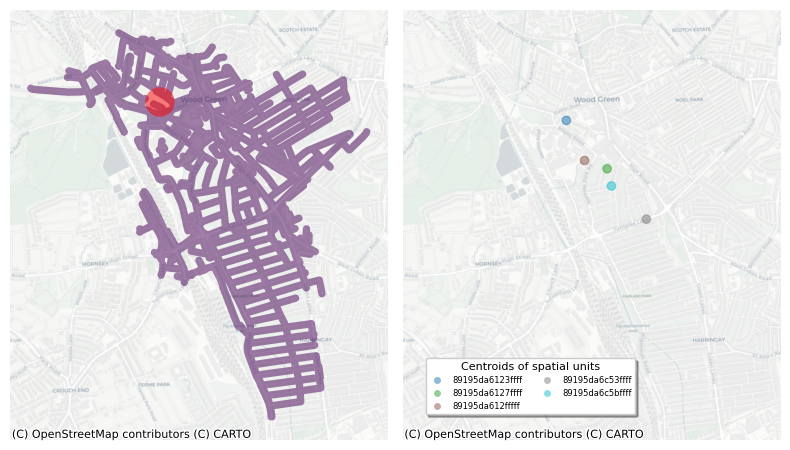

In [118]:
woodgreen_pt = create_buffered_point(-0.1142536, 51.5971439) # Wood Green  
plot_max_activity_cluster(df_clus_activity,df_mem_activity,woodgreen_pt) 

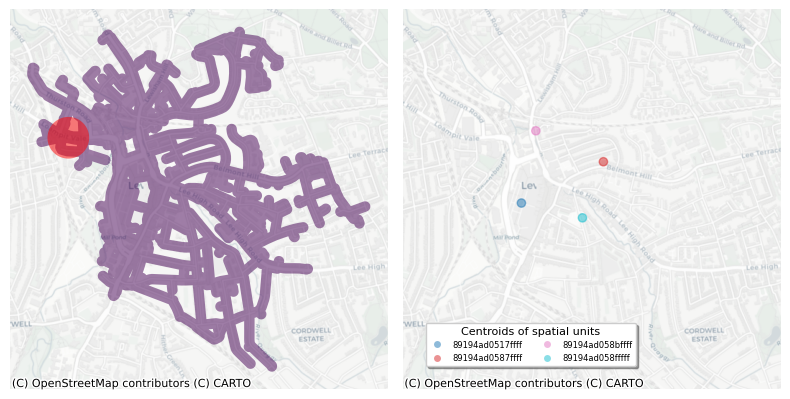

In [119]:
lewisham_pt = create_buffered_point(-0.0160783, 51.464583) # Lewisham
plot_max_activity_cluster(df_clus_activity,df_mem_activity,lewisham_pt)

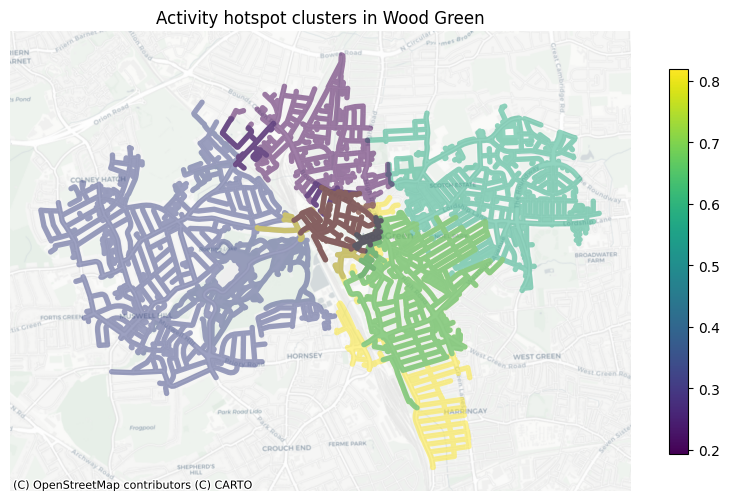

In [ ]:
#plot
fig,ax = plt.subplots(figsize=(10,10))
df_area.plot(ax=ax,
                  alpha=0.5,
                  legend=True, 
                  cmap = 'viridis',
                  column='mean_activity_hotspot',
                  legend_kwds={'shrink': 0.5},
                  label='activity_cluster')
ctx.add_basemap(ax, crs=27700, source=ctx.providers.CartoDB.Positron)

ax.axis('off')
plt.title('Activity hotspot clusters in Wood Green')
plt.show()